# Gaussian-distributed noise tests on visibilities (adapted from 'plot_pygtc.py')

## simp3_medv_medr

In [4]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina' # For mac users with Retina display
from matplotlib import pyplot as plt
import numpy as np
import pygtc
import os, sys
import matplotlib.pyplot as plt
import emcee
import copy

wdir = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/fake_data/noise_draws/'
lbls = [r'$i$', r'$PA$', r'$M$', r'$r_l$', r'$z0$', r'$z_{\psi}$', r'$Tb_{0}$', r'$Tb_q$', r'$T_{\rm{back}}$', r'$dV_{0}$', r'$v_{\rm{sys}}$', r'$dx$', r'$dy$']

# emcee backend files
postfiles = np.loadtxt(wdir+'posteriors.txt', dtype=str)

# scale burn-in
# burnin = 1000

# calculate autocorrelation time as a function of step?
calc_tau = False
Ntau = 100

# load the backend; parse the samples
def make_chain(filename, burnin, stray, trace, theta):
    reader = emcee.backends.HDFBackend(wdir + filename)
    all_samples = reader.get_chain(discard=0, flat=False)
    samples = reader.get_chain(discard=burnin, flat=False)
    log_prob_samples = reader.get_log_prob(discard=burnin, flat=False)
    log_prior_samples = reader.get_blobs(discard=burnin, flat=False)
    maxlnprob = np.max(reader.get_log_prob(discard=0, flat=False))
    minlnprob = np.min(reader.get_log_prob(discard=0, flat=False))
    nsteps, nwalk, ndim = samples.shape[0], samples.shape[1], samples.shape[2]
    
    # finding that stray walker
    if stray == True:
        prob = np.array(reader.get_log_prob(discard=burnin, flat=False))
        prob_mean = np.mean(prob, axis=0) # finds mean prob per walker
        rm_idx = np.where(prob_mean == np.min(prob_mean)) # gives index of lowest mean probability walker
        new_samp = np.delete(samples, rm_idx, axis=1) # removes lowest mean probability walker from samples
        nsteps, nwalk, ndim = new_samp.shape[0], new_samp.shape[1], new_samp.shape[2]
        #print(nsteps, nwalk, ndim)
    
        if trace == True:
            # for trace plot (disable return)
            for i in range(ndim):
                fig = plt.figure(figsize=(5, 5))
                plt.plot(np.arange(nsteps), new_samp[:,:,i], alpha=0.3)
                plt.plot([0, nsteps], [theta[i], theta[i]], 'r', lw=2)
                plt.ylabel(lbls[i], fontsize=12)
                plt.title('Trace %s' % lbls[i])
                plt.xticks(fontsize=12)
                plt.yticks(fontsize=12)
                plt.show()
        
        else:     
            # corner plot to view covariances
            levs = 1. - np.exp(-0.5*(np.arange(3)+1)**2)
            flat_chain = new_samp.reshape(-1, ndim)
            return(flat_chain)
    
    
    else:
        if trace == True:
        # for trace plot (disable return)
            for i in range(ndim):
                fig = plt.figure(figsize=(5, 5))
                plt.plot(np.arange(nsteps), samples[:,:,i], alpha=0.3)
                plt.plot([0, nsteps], [theta[i], theta[i]], 'r', lw=2)
                plt.ylabel(lbls[i], fontsize=12)
                plt.title('Trace %s' % lbls[i])
                plt.xticks(fontsize=12)
                plt.yticks(fontsize=12)
                plt.show()
        else:
            flat_chain = samples.reshape(-1, ndim)
            return(flat_chain)

In [2]:
base = make_chain(postfiles[0], 1000, stray=True)
rms0 = make_chain(postfiles[1], 1000, stray=True)
rms1 = make_chain(postfiles[2], 1000, stray=True)
rms2 = make_chain(postfiles[3], 1000, stray=True)
rms3 = make_chain(postfiles[4], 1000, stray=True)
rms4 = make_chain(postfiles[5], 1000, stray=True)
rms5 = make_chain(postfiles[6], 1000, stray=True)
rms6 = make_chain(postfiles[7], 1000, stray=True)
rms7 = make_chain(postfiles[8], 1000, stray=True)
rms8 = make_chain(postfiles[9], 1000, stray=True)
chains = [base, rms0, rms1, rms2, rms3, rms4, rms5, rms6, rms7, rms8]

In [18]:
# finding best-fit parameters using post_summary
from post_summary import post_summary
import time

# set parameter labels, chain labels
chains = [base, rms0, rms1, rms2, rms3, rms4, rms5, rms6, rms7, rms8]
chainLabels= ['base', 'rms0', 'rms1', 'rms2', 'rms3', 'rms4', 'rms5', 'rms6', 'rms7', 'rms8']
names = ['i', 'PA', 'M', 'r_l', 'z0', 'zpsi', 'Tb0', 'Tbq', 'Tback', 'dV0', 'vsys', 'dx', 'dy']

t0 = time.time()
#savedir = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/fake_data/noise_draws/posterior_plots/'
#sys.stdout = open(savedir + "noisy_best_fit.txt", "a")
for i in range(len(chains)):
    print('%s best-fit parameters' % (chainLabels[i]))
    for j in range(len(names)-3):
        post_param = post_summary(chains[i][:,j], prec=0.001, mu='peak')
        print('%s = %.2f +%.3f / -%.3f' % (names[j], post_param[0], post_param[1], post_param[2]))
    print()

t1 = time.time() 
print("This took %s minutes to run." % ((t1-t0)/60))
#sys.stdout.close()


base best-fit parameters
i = 40.81 +0.266 / -0.260
PA = 130.24 +0.079 / -0.107
M = 0.67 +0.013 / -0.006
r_l = 200.05 +1.614 / -0.075
z0 = 2.02 +0.113 / -0.157
zpsi = 1.03 +0.017 / -0.025
Tb0 = 198.75 +6.480 / -4.431
Tbq = 0.48 +0.009 / -0.005
Tback = 22.44 +2.473 / -2.172
dV0 = 331.87 +6.462 / -8.365

rms0 best-fit parameters
i = 40.20 +0.228 / -0.278
PA = 130.08 +0.108 / -0.084
M = 0.69 +0.008 / -0.006
r_l = 201.61 +0.869 / -0.607
z0 = 2.11 +0.153 / -0.111
zpsi = 1.02 +0.024 / -0.020
Tb0 = 220.04 +4.726 / -6.632
Tbq = 0.53 +0.005 / -0.007
Tback = 19.47 +1.823 / -1.405
dV0 = 361.90 +7.589 / -8.107

rms1 best-fit parameters
i = 41.28 +0.139 / -0.212
PA = 130.03 +0.082 / -0.101
M = 0.67 +0.007 / -0.003
r_l = 201.41 +0.371 / -0.455
z0 = 2.35 +0.120 / -0.092
zpsi = 0.99 +0.014 / -0.015
Tb0 = 204.99 +6.312 / -4.397
Tbq = 0.51 +0.005 / -0.006
Tback = 12.00 +1.415 / -1.130
dV0 = 368.08 +8.598 / -8.631

rms2 best-fit parameters
i = 39.52 +0.384 / -0.161
PA = 130.29 +0.099 / -0.112
M = 0.72 +0.

In [5]:
# percentile way
for i in range(len(chains)):
    print('%s best-fit parameters' % (chainLabels[i]))
    for j in range(len(names)):
        mcmc = np.percentile(chains[i][:,j], [16, 50, 84])
        q = np.diff(mcmc)
        print('%s = %.2f +%.2f / -%.2f' % (names[j], mcmc[1], q[0], q[1]))
    print()

base best-fit parameters
i = 40.79 +0.23 / -0.29
PA = 130.23 +0.10 / -0.09
M = 0.67 +0.01 / -0.01
r_l = 200.40 +0.42 / -1.27
z0 = 2.00 +0.13 / -0.13
zpsi = 1.03 +0.02 / -0.02
Tb0 = 199.53 +5.18 / -5.68
Tbq = 0.48 +0.01 / -0.01
Tback = 22.57 +2.29 / -2.33
dV0 = 331.20 +7.65 / -7.08
vsys = 4.00 +0.00 / -0.00
dx = -0.00 +0.00 / -0.00
dy = -0.00 +0.00 / -0.00

rms0 best-fit parameters
i = 40.18 +0.26 / -0.25
PA = 130.09 +0.09 / -0.10
M = 0.69 +0.01 / -0.01
r_l = 201.72 +0.71 / -0.76
z0 = 2.13 +0.13 / -0.14
zpsi = 1.02 +0.02 / -0.02
Tb0 = 218.91 +5.48 / -5.81
Tbq = 0.53 +0.01 / -0.01
Tback = 19.60 +1.52 / -1.69
dV0 = 361.62 +7.78 / -7.83
vsys = 4.00 +0.00 / -0.00
dx = -0.00 +0.00 / -0.00
dy = -0.00 +0.00 / -0.00

rms1 best-fit parameters
i = 41.26 +0.19 / -0.16
PA = 130.02 +0.09 / -0.09
M = 0.67 +0.00 / -0.01
r_l = 201.38 +0.42 / -0.40
z0 = 2.36 +0.10 / -0.11
zpsi = 0.99 +0.01 / -0.01
Tb0 = 205.59 +4.98 / -5.68
Tbq = 0.51 +0.01 / -0.01
Tback = 12.11 +1.23 / -1.30
dV0 = 368.01 +8.50 / -8.62


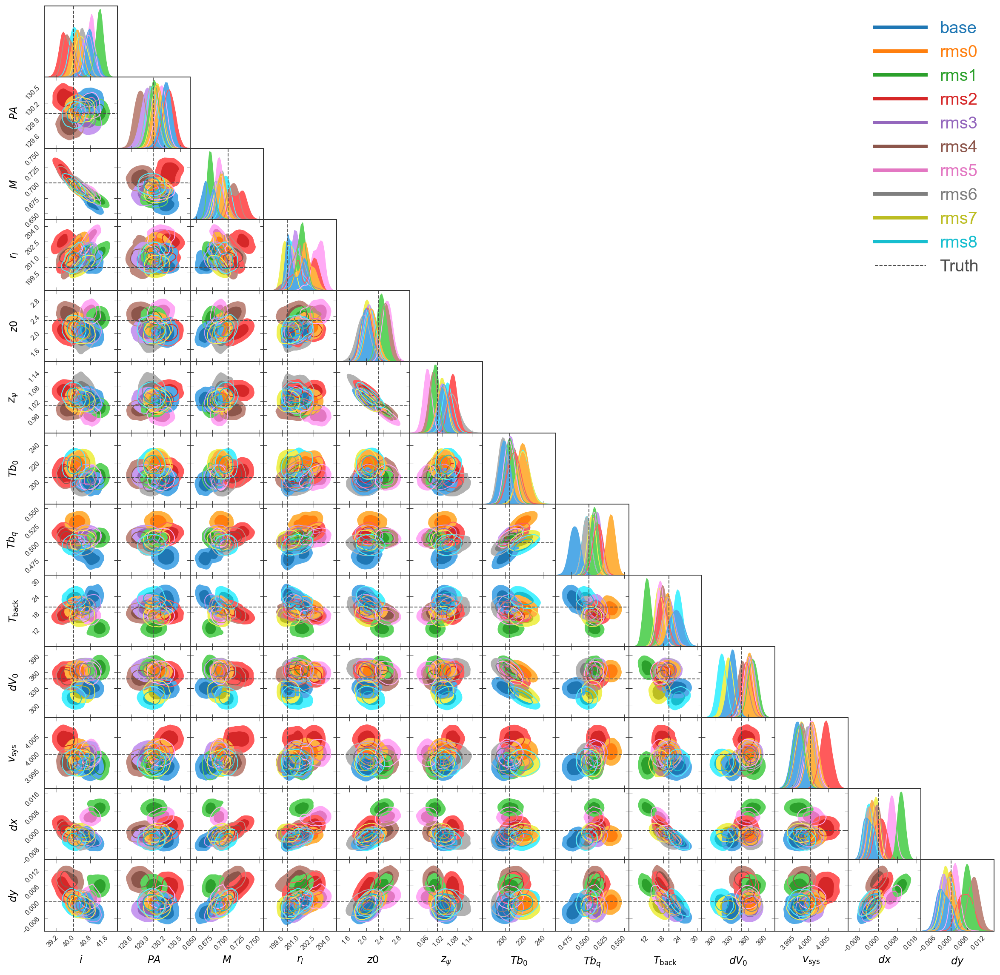

In [6]:
# making corner plots
theta = [40, 130, 0.7, 200, 2.3, 1.0, 205., 0.5, 20., 347.7, 4., 0., 0.]
lbls = [r'$i$', r'$PA$', r'$M$', r'$r_l$', r'$z0$', r'$z_{\psi}$', r'$Tb_{0}$', r'$Tb_q$', r'$T_{\rm{back}}$', r'$dV_{0}$', r'$v_{\rm{sys}}$', r'$dx$', r'$dy$']

chains = [base, rms0, rms1, rms2, rms3, rms4, rms5, rms6, rms7, rms8]
chainLabels= ['base', 'rms0', 'rms1', 'rms2', 'rms3', 'rms4', 'rms5', 'rms6', 'rms7', 'rms8']

# full corner plot
GTC = pygtc.plotGTC(chains=chains, truths=theta, paramNames=lbls, chainLabels=chainLabels,
                    truthLabels='Truth', legendMarker = 'All', customTickFont= {'family':'Arial', 'size':8},
                    customLabelFont = {'family':'Arial', 'size':12}, customLegendFont = {'family':'Arial', 'size':20},
                    figureSize=20)
# GTC.savefig(wdir + 'posterior_plots/cornerplot_no_rms0.png', dpi=300)

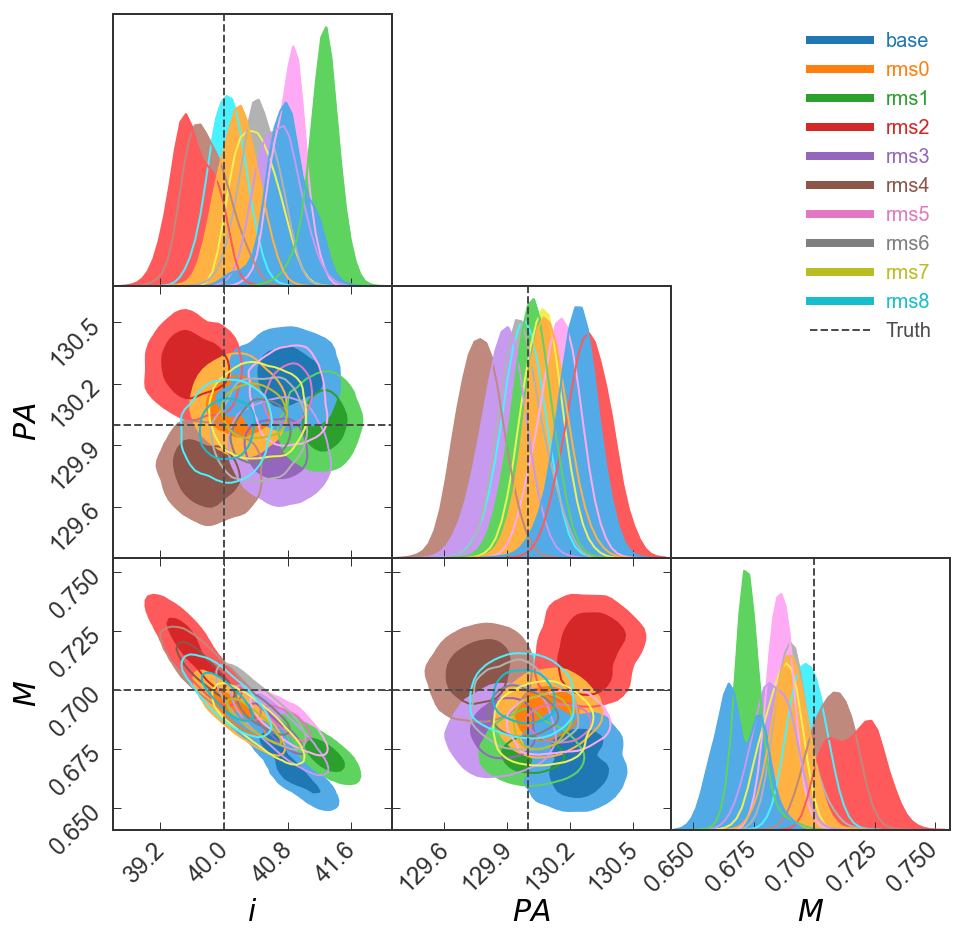

In [7]:
# I, PA, and M

ipam_base = np.stack((base[:,0], base[:,1], base[:,2]), axis=-1)
ipam_rms0 = np.stack((rms0[:,0], rms0[:,1], rms0[:,2]), axis=-1)
ipam_rms1 = np.stack((rms1[:,0], rms1[:,1], rms1[:,2]), axis=-1)
ipam_rms2 = np.stack((rms2[:,0], rms2[:,1], rms2[:,2]), axis=-1)
ipam_rms3 = np.stack((rms3[:,0], rms3[:,1], rms3[:,2]), axis=-1)
ipam_rms4 = np.stack((rms4[:,0], rms4[:,1], rms4[:,2]), axis=-1)
ipam_rms5 = np.stack((rms5[:,0], rms5[:,1], rms5[:,2]), axis=-1)
ipam_rms6 = np.stack((rms6[:,0], rms6[:,1], rms6[:,2]), axis=-1)
ipam_rms7 = np.stack((rms7[:,0], rms7[:,1], rms7[:,2]), axis=-1)
ipam_rms8 = np.stack((rms8[:,0], rms8[:,1], rms8[:,2]), axis=-1)

ipam = [ipam_base, ipam_rms0, ipam_rms1, ipam_rms2, ipam_rms3, ipam_rms4, ipam_rms5, ipam_rms6, ipam_rms7, ipam_rms8]

GTC = pygtc.plotGTC(chains=ipam, truths=[40, 130, 0.7], paramNames=[r'$i$', r'$PA$', r'$M$'], chainLabels = chainLabels,
                    truthLabels='Truth', legendMarker = 'All', customTickFont = {'family':'Arial', 'size':12},
                    customLabelFont = {'family':'Arial', 'size':15}, customLegendFont = {'family':'Arial', 'size':10},
                    figureSize=7.5)
# savefolder = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/fake_data/noise_draws/posterior_plots/'
# GTC.savefig(savefolder + 'cornerplot_all_rms_i_pa_m.png', dpi=300)

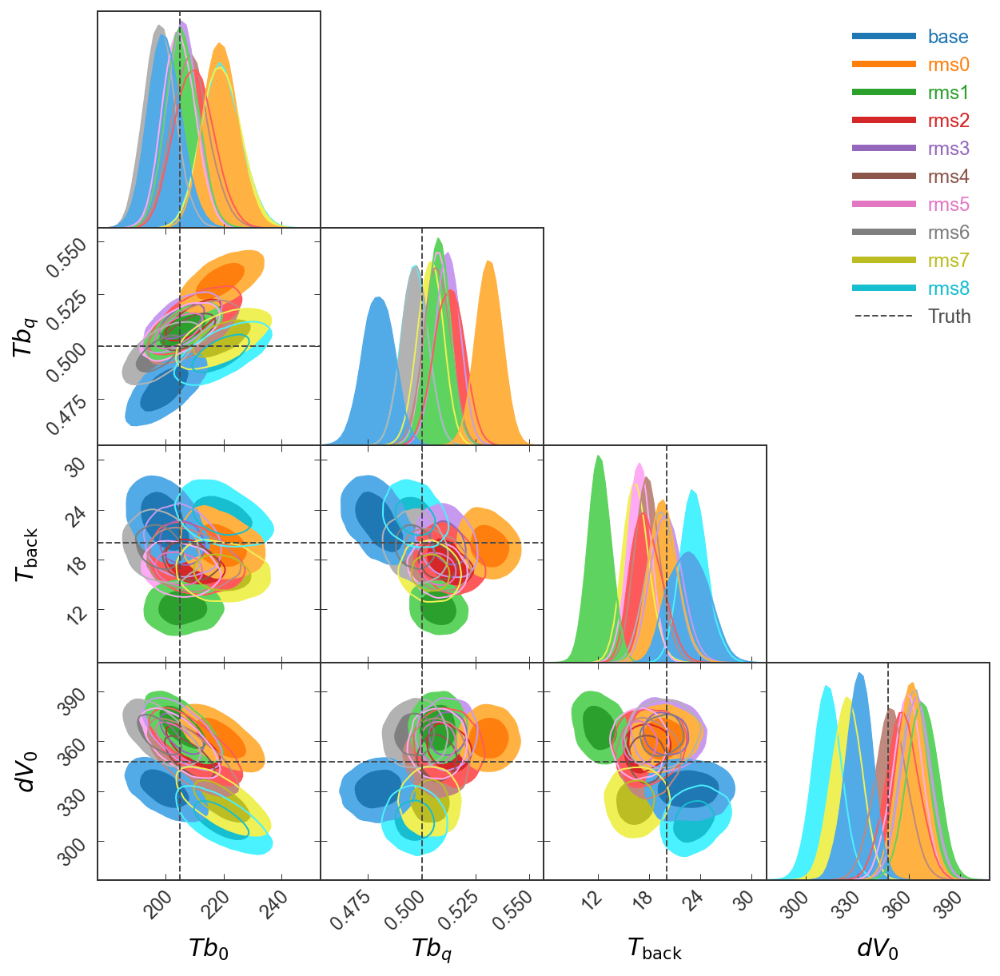

In [8]:
# Tb0, Tback, Tbq, dv0
temp_base = np.stack((base[:,6], base[:,7], base[:,8], base[:,9]), axis=-1)
temp_rms0 = np.stack((rms0[:,6], rms0[:,7], rms0[:,8], rms0[:,9]), axis=-1)
temp_rms1 = np.stack((rms1[:,6], rms1[:,7], rms1[:,8], rms1[:,9]), axis=-1)
temp_rms2 = np.stack((rms2[:,6], rms2[:,7], rms2[:,8], rms2[:,9]), axis=-1)
temp_rms3 = np.stack((rms3[:,6], rms3[:,7], rms3[:,8], rms3[:,9]), axis=-1)
temp_rms4 = np.stack((rms4[:,6], rms4[:,7], rms4[:,8], rms4[:,9]), axis=-1)
temp_rms5 = np.stack((rms5[:,6], rms5[:,7], rms5[:,8], rms5[:,9]), axis=-1)
temp_rms6 = np.stack((rms6[:,6], rms6[:,7], rms6[:,8], rms6[:,9]), axis=-1)
temp_rms7 = np.stack((rms7[:,6], rms7[:,7], rms7[:,8], rms7[:,9]), axis=-1)
temp_rms8 = np.stack((rms8[:,6], rms8[:,7], rms8[:,8], rms8[:,9]), axis=-1)

temp = [temp_base, temp_rms0, temp_rms1, temp_rms2, temp_rms3, temp_rms4, temp_rms5, temp_rms6, temp_rms7, temp_rms8]

GTC = pygtc.plotGTC(chains=temp, truths=[205., 0.5, 20., 347.7], paramNames=[r'$Tb_{0}$', r'$Tb_q$', r'$T_{\rm{back}}$', r'$dV_{0}$'], chainLabels = chainLabels,
                    truthLabels='Truth', legendMarker = 'All', customTickFont = {'family':'Arial', 'size':12},
                    customLabelFont = {'family':'Arial', 'size':15}, customLegendFont = {'family':'Arial', 'size':12},
                    figureSize=10)
#savefolder = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/fake_data/noise_draws/posterior_plots/'
#GTC.savefig(savefolder + 'cornerplot_all_rms_tb0_tbq_tback_dv0.png', dpi=300)

In [9]:
# master noise
all_noise = np.concatenate((chains), axis=0)
theta = [40, 130, 0.7, 200, 2.3, 1.0, 205., 0.5, 20., 347.7, 4., 0., 0.]

#savedir = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/fake_data/noise_draws/posterior_plots/'
#sys.stdout = open(savedir + "noisy_best_fit.txt", "a")

print('all_noise best-fit parameters')
for j in range(len(names)-3):
    post_param = post_summary(all_noise[:,j], prec=0.01, mu='peak')
    print('%s = %.2f +%.2f / -%.2f' % (names[j], post_param[0], post_param[1], post_param[2]))
print()

#sys.stout.close()

all_noise best-fit parameters
i = 40.56 +0.39 / -0.74
PA = 130.03 +0.20 / -0.17
M = 0.69 +0.02 / -0.02
r_l = 201.10 +1.21 / -0.89
z0 = 2.04 +0.39 / -0.11
zpsi = 1.02 +0.03 / -0.04
Tb0 = 204.94 +14.43 / -5.55
Tbq = 0.52 +0.00 / -0.02
Tback = 17.48 +4.70 / -1.93
dV0 = 361.38 +6.72 / -37.66



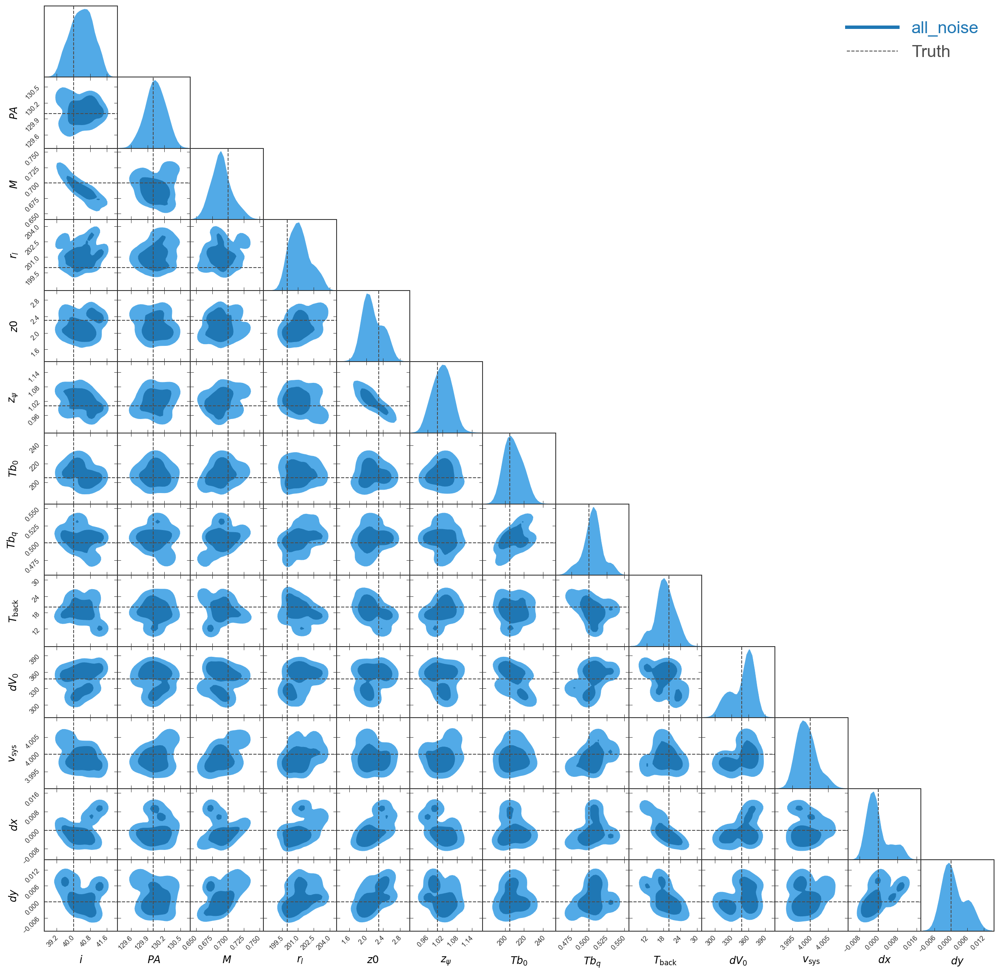

In [10]:
# full corner plot
GTC = pygtc.plotGTC(chains=all_noise, truths=theta, paramNames=lbls, chainLabels='all_noise',
                    truthLabels='Truth', legendMarker = 'All', customTickFont= {'family':'Arial', 'size':8},
                    customLabelFont = {'family':'Arial', 'size':12}, customLegendFont = {'family':'Arial', 'size':20},
                    figureSize=20)
# GTC.savefig(wdir + 'posterior_plots/cornerplot_no_rms0.png', dpi=300)

In [11]:
# finding best-fit parameters using post_summary
from post_summary import post_summary

# set parameter labels, chain labels
chains = [base, rms0, rms1, rms2, rms3, rms4, rms5, rms6, rms7, rms8, all_noise]
chainLabels= ['base', 'rms0', 'rms1', 'rms2', 'rms3', 'rms4', 'rms5', 'rms6', 'rms7', 'rms8', 'all']
names = ['i', 'PA', 'M', 'r_l', 'z0', 'zpsi', 'Tb0', 'Tbq', 'Tback', 'dV0', 'vsys', 'dx', 'dy']

#savedir = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/fake_data/noise_draws/posterior_plots/'
#sys.stdout = open(savedir + "noisy_best_fit.txt", "a")

def get_param(idx):
    r = []
    for i in range(len(chains)):
        value, hi, lo = post_summary(chains[i][:,idx], prec=0.001, mu='peak')
        r.append([value, lo, hi])
    return(np.array(r))
    
i_plot = get_param(0)
pa_plot = get_param(1)
m_plot = get_param(2)
r_plot = get_param(3)
z0_plot = get_param(4)
zpsi_plot = get_param(5)
Tb0_plot = get_param(6)
Tbq_plot = get_param(7)
Tback_plot = get_param(8)
dV0_plot = get_param(9)

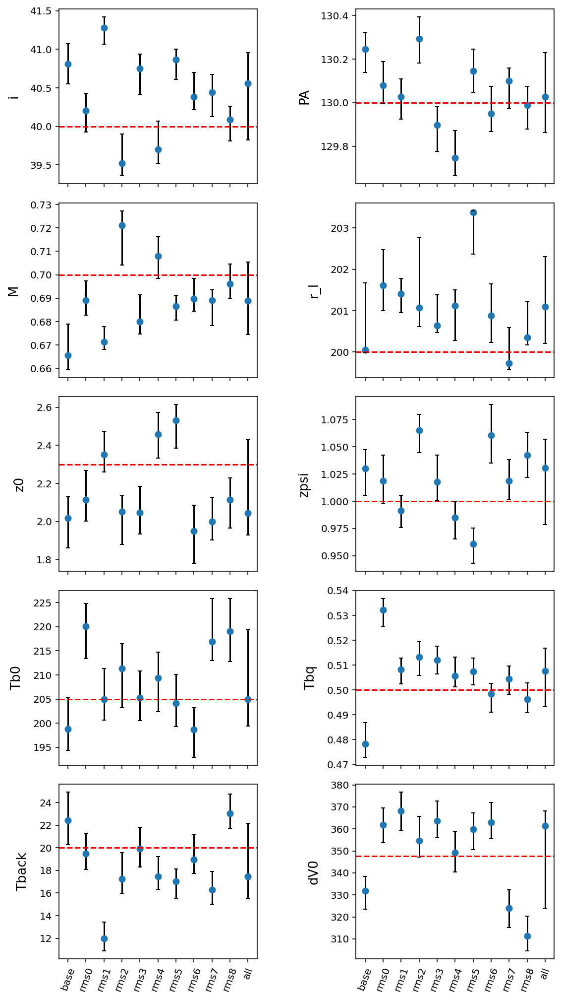

In [12]:
# make subplots
fig, axs = plt.subplots(5, 2, figsize=(8, 15), sharex=True)
params = [i_plot, pa_plot, m_plot, r_plot, z0_plot, zpsi_plot, Tb0_plot, Tbq_plot, Tback_plot, dV0_plot]
fig.tight_layout()
plt.subplots_adjust(wspace=0.5, left=0.1, bottom=0.1)
for i, ax in enumerate(fig.axes):
    ax.plot(chainLabels, params[i][:,0], 'o')
    ax.axhline(theta[i], color='r', linestyle='--')
    ax.errorbar(chainLabels, params[i][:,0], yerr=params[i][:,1:3].T, ls='none', capsize=2, fmt ='k')
    ax.set_ylabel('%s' % (names[i]), fontsize=13, labelpad=10)
    ax.tick_params(axis='x', labelsize=10, labelrotation=70)
    
wdir = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/fake_data/noise_draws/posterior_plots/'
plt.savefig(wdir + 'rms_noisy_params_1e-3_prec.png', dpi=300)


## simp5_medv_medr

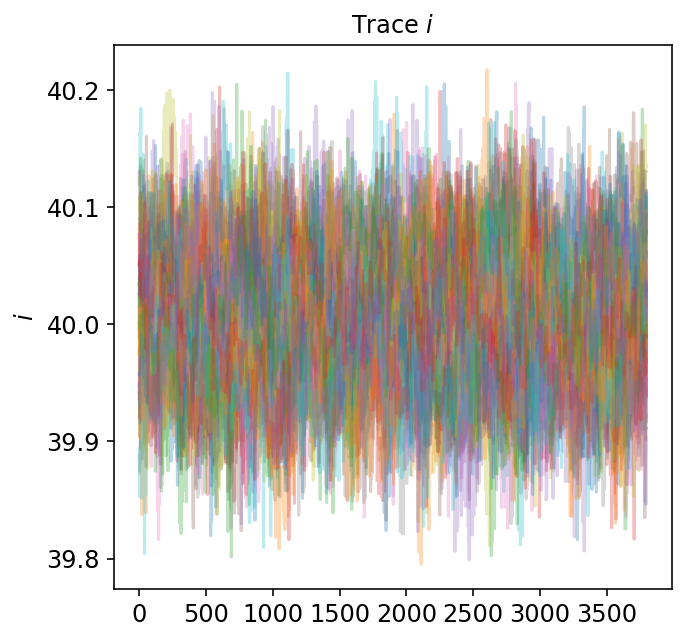

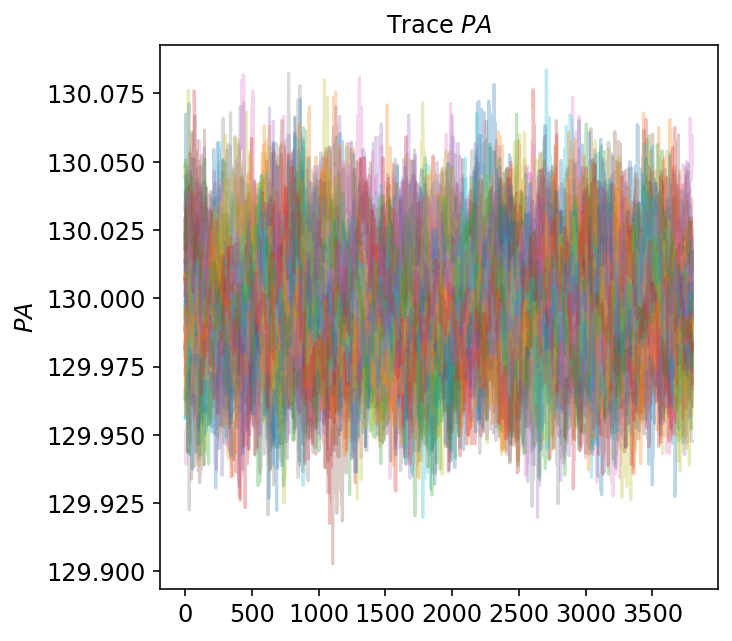

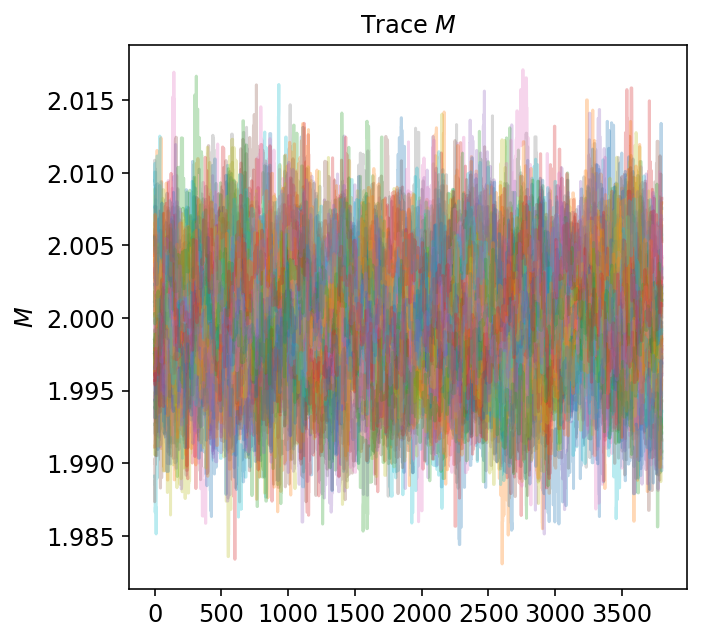

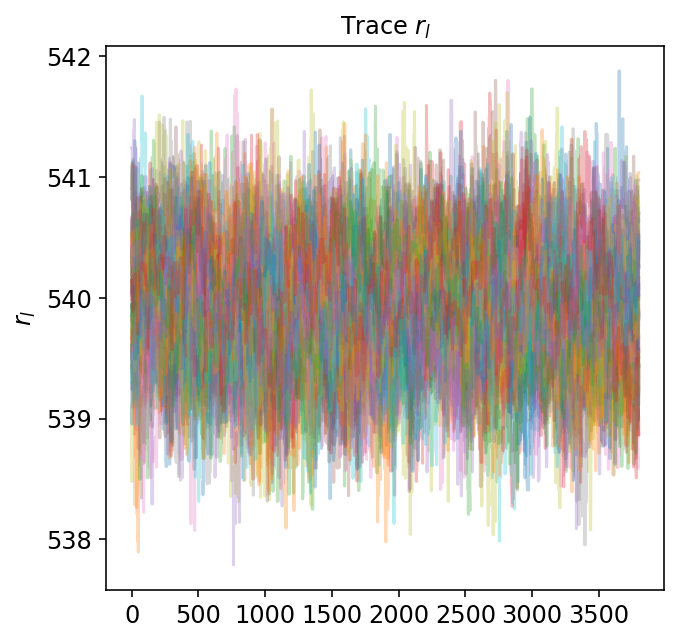

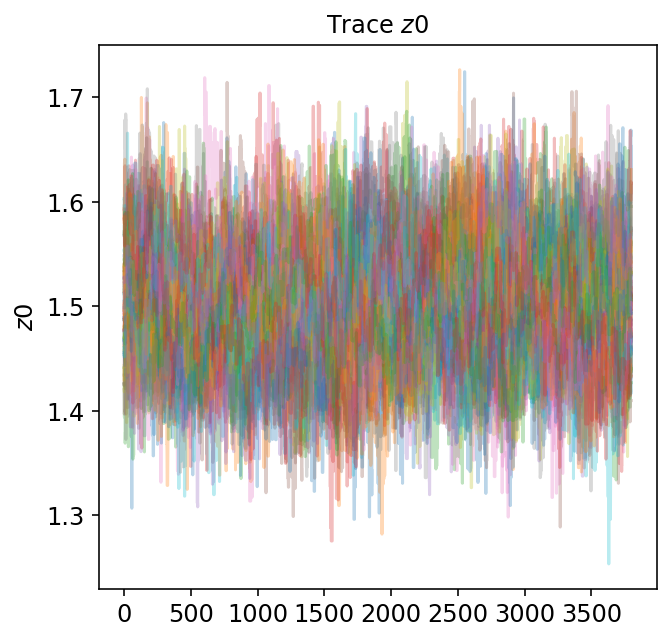

...

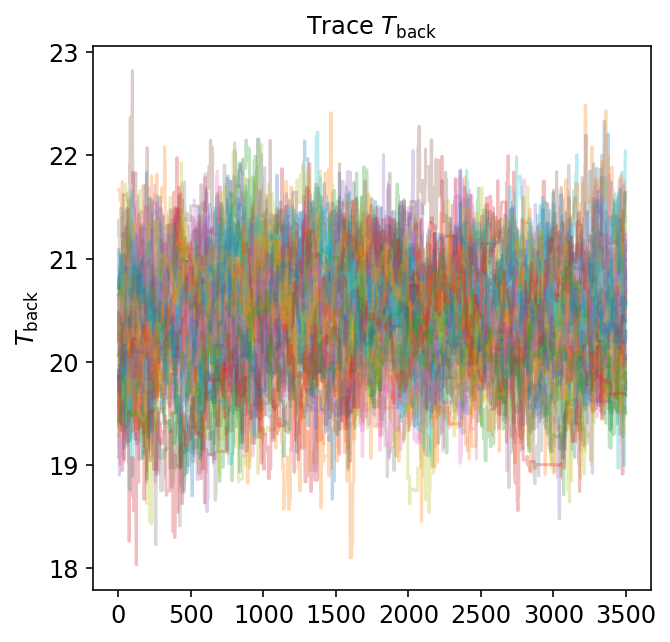

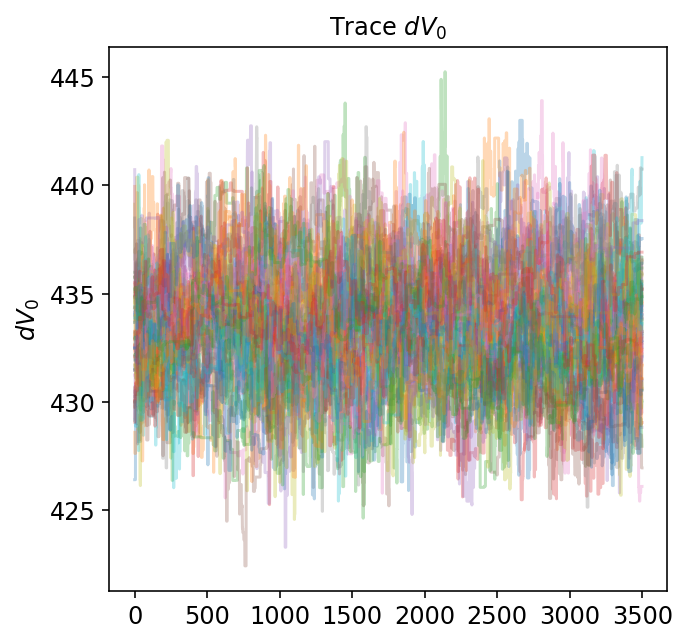

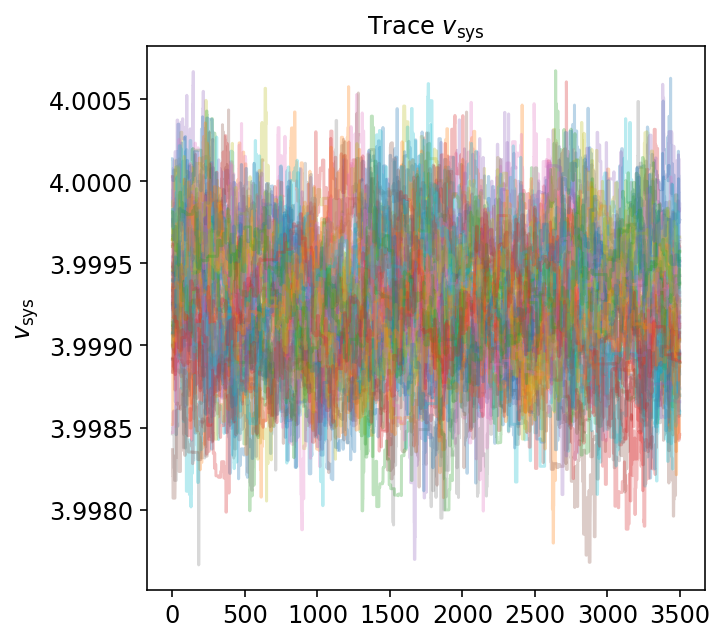

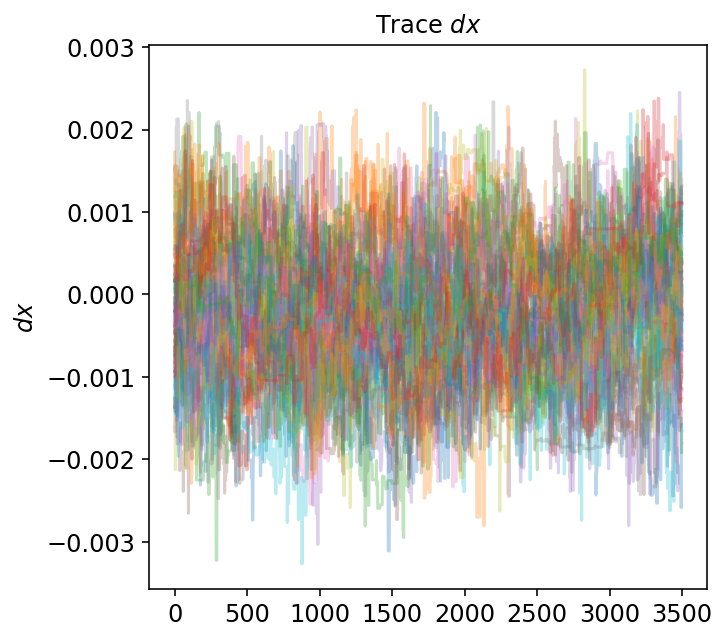

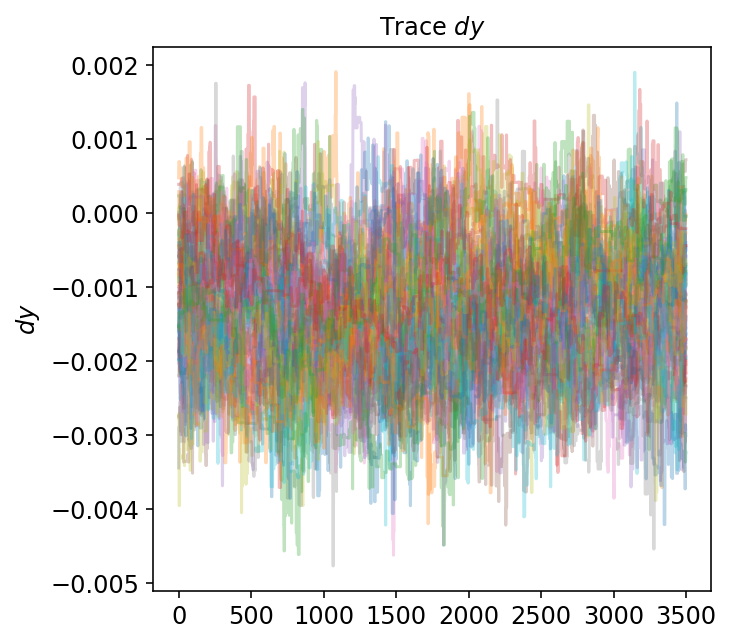

In [13]:
wdir = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/posteriors/'
noiseless = make_chain('simp5_std_medr_medv_noiseless.h5', 1200, stray=False)
noisy = make_chain('simp5_std_medr_medv_noisy.h5', 1500, stray=True)

In [24]:
wdir = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/posteriors/'
noiseless = make_chain('simp5_std_medr_medv_noiseless.h5', 1200, stray=False)
noisy = make_chain('simp5_std_medr_medv_noisy.h5', 1500, stray=True)

In [28]:
from post_summary import post_summary

simp5_med = [noiseless, noisy]
simp5_lbl = ['noiseless', 'noisy']
names = ['i', 'PA', 'M', 'r_l', 'z0', 'zpsi', 'Tb0', 'Tbq', 'Tback', 'dV0', 'vsys', 'dx', 'dy']

for i in range(len(simp5)):
    print('simp5 %s best-fit parameters' % (simp5_lbl[i]))
    for j in range(len(names)-3):
        post_param = post_summary(simp5_med[i][:,j], prec=0.001, mu='peak')
        print('%s = %.2f +%.3f / -%.3f' % (names[j], post_param[0], post_param[1], post_param[2]))
    print()

simp5 noiseless best-fit parameters
i = 40.00 +0.054 / -0.053
PA = 130.00 +0.019 / -0.022
M = 2.00 +0.005 / -0.004
r_l = 539.96 +0.435 / -0.518
z0 = 1.49 +0.060 / -0.048
zpsi = 1.00 +0.011 / -0.008
Tb0 = 330.61 +2.253 / -2.232
Tbq = 0.50 +0.001 / -0.001
Tback = 19.99 +0.548 / -0.498
dV0 = 440.64 +2.334 / -3.147

simp5 noisy best-fit parameters
i = 40.04 +0.046 / -0.056
PA = 130.04 +0.028 / -0.003
M = 2.00 +0.003 / -0.005
r_l = 540.20 +1.096 / -0.139
z0 = 1.42 +0.049 / -0.053
zpsi = 1.02 +0.009 / -0.009
Tb0 = 336.38 +2.182 / -2.494
Tbq = 0.50 +0.001 / -0.001
Tback = 20.49 +0.452 / -0.620
dV0 = 433.51 +2.505 / -2.448



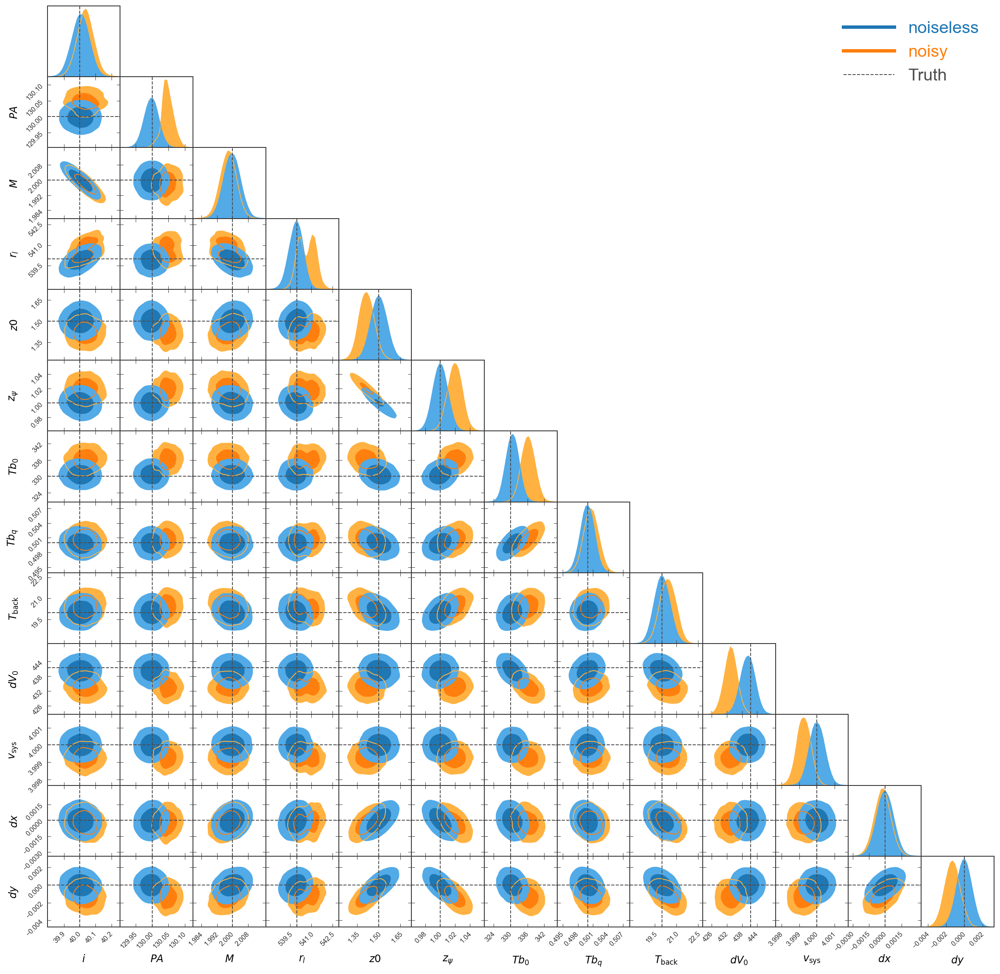

In [25]:
import pygtc

simp5_med = [noiseless, noisy]
simp5_lbl = ['noiseless', 'noisy']

# making corner plots
theta = [40, 130, 2.0, 540, 1.5, 1, 330, 0.5, 20, 441.4, 4.0, 0, 0]
lbls = [r'$i$', r'$PA$', r'$M$', r'$r_l$', r'$z0$', r'$z_{\psi}$', r'$Tb_{0}$', r'$Tb_q$', r'$T_{\rm{back}}$', r'$dV_{0}$', r'$v_{\rm{sys}}$', r'$dx$', r'$dy$']

# full corner plot
GTC = pygtc.plotGTC(chains=simp5_med, truths=theta, paramNames=lbls, chainLabels=simp5_lbl,
                    truthLabels='Truth', legendMarker = 'All', customTickFont= {'family':'Arial', 'size':8},
                    customLabelFont = {'family':'Arial', 'size':12}, customLegendFont = {'family':'Arial', 'size':20},
                    figureSize=20)
# GTC.savefig(wdir + 'posterior_plots/cornerplot_no_rms0.png', dpi=300)

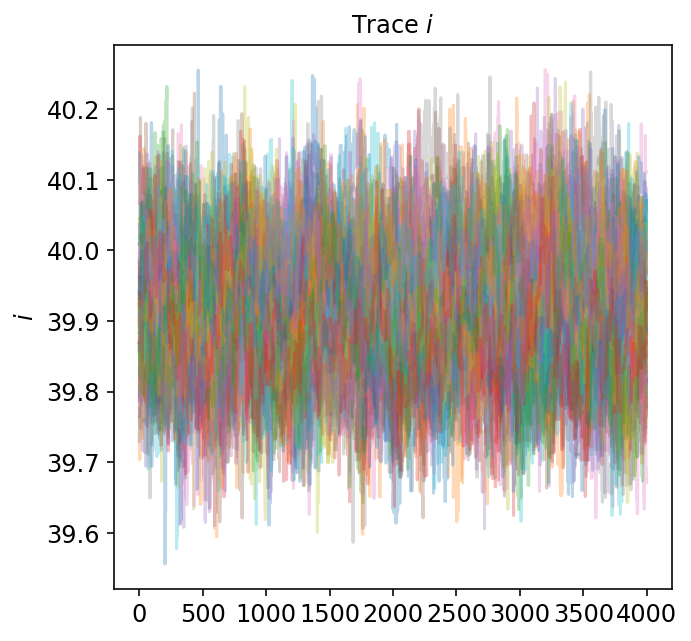

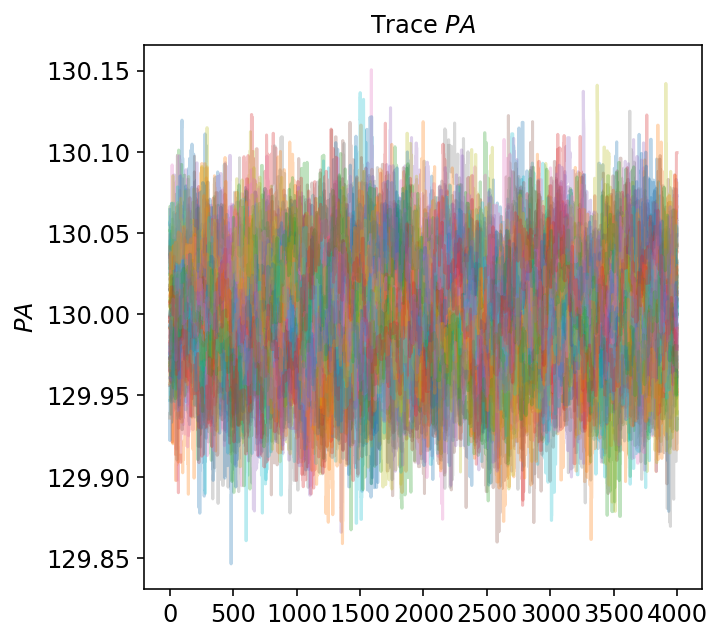

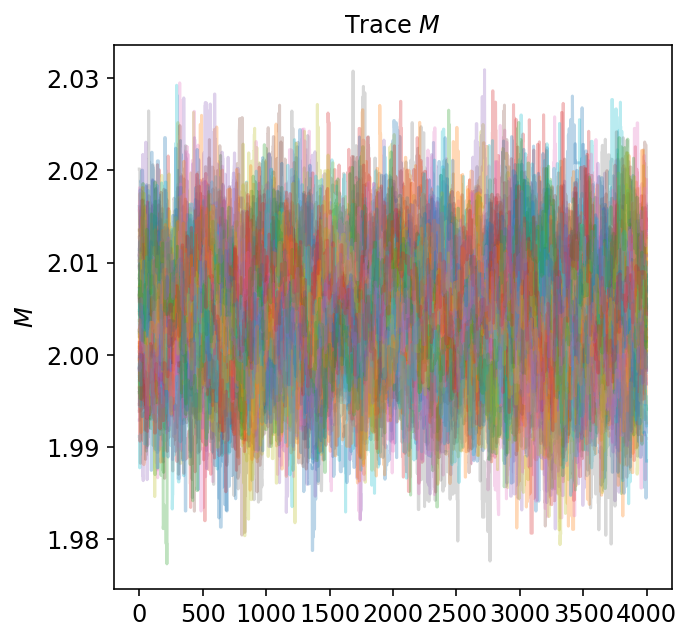

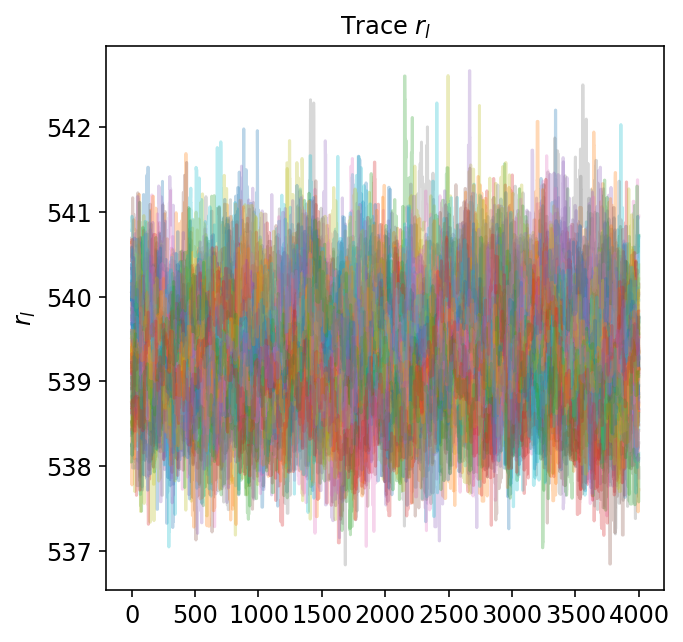

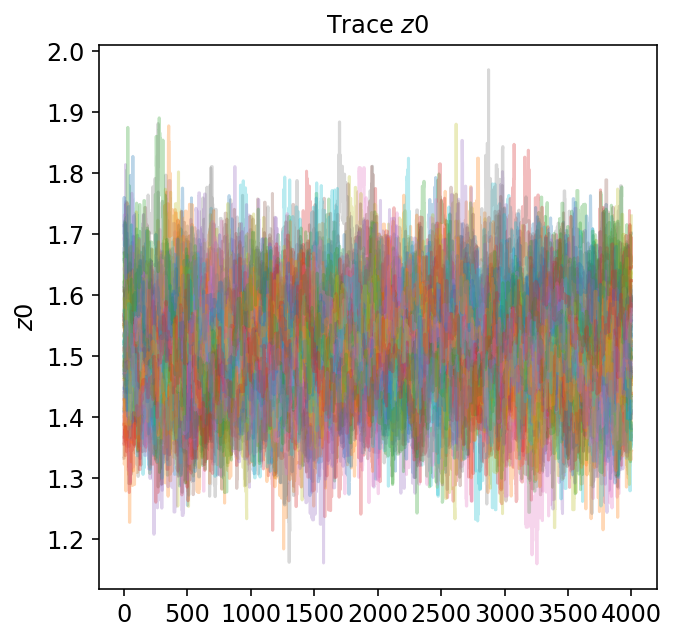

...

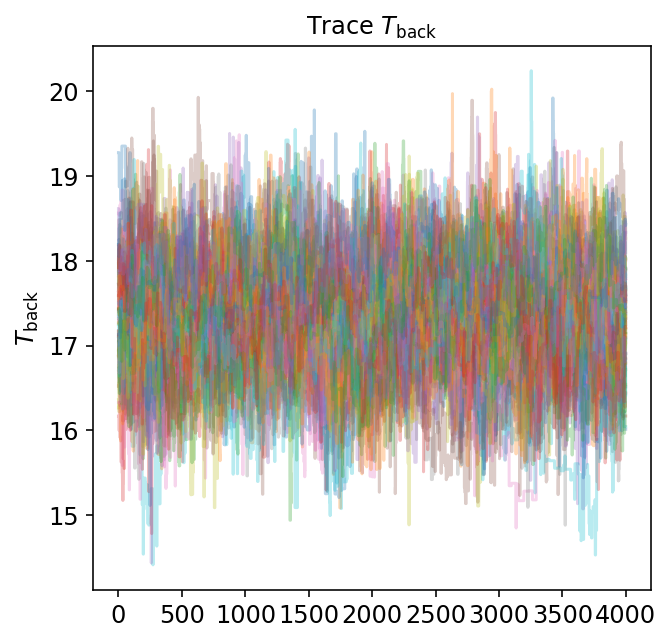

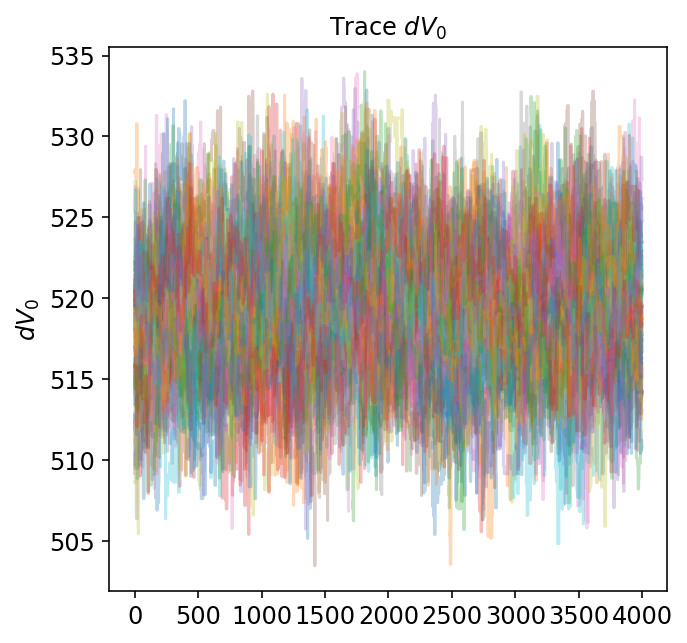

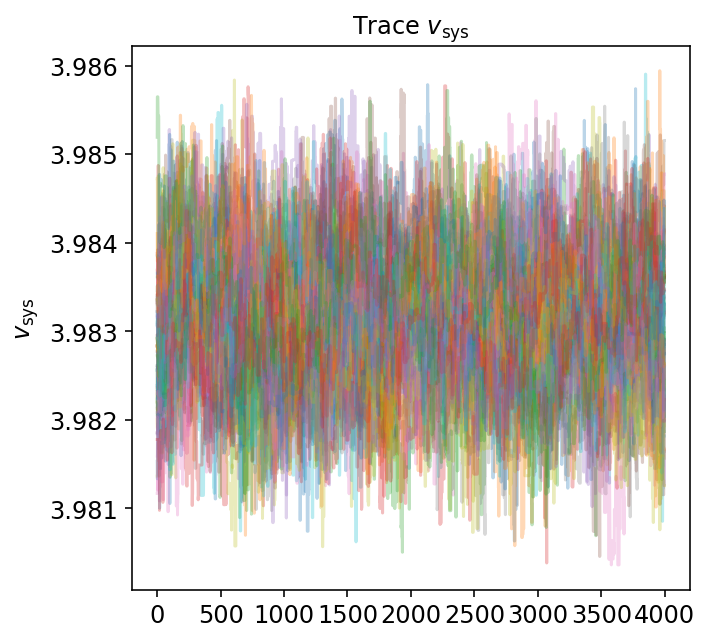

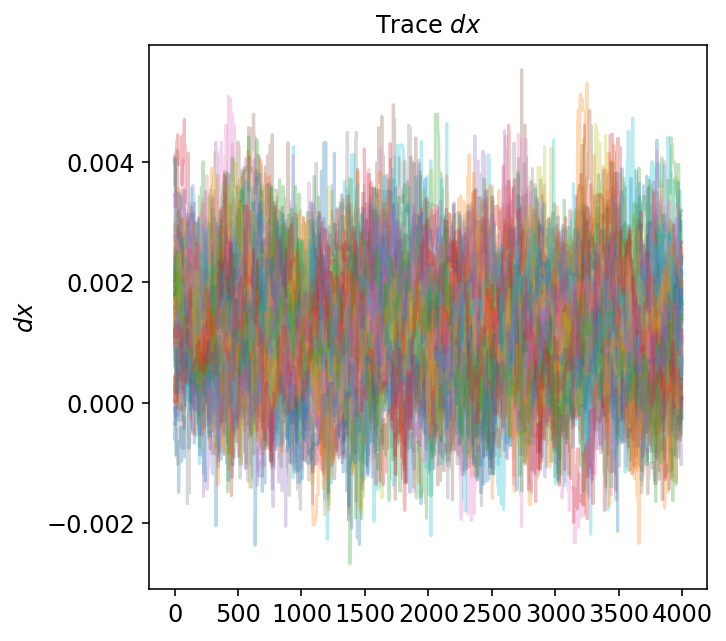

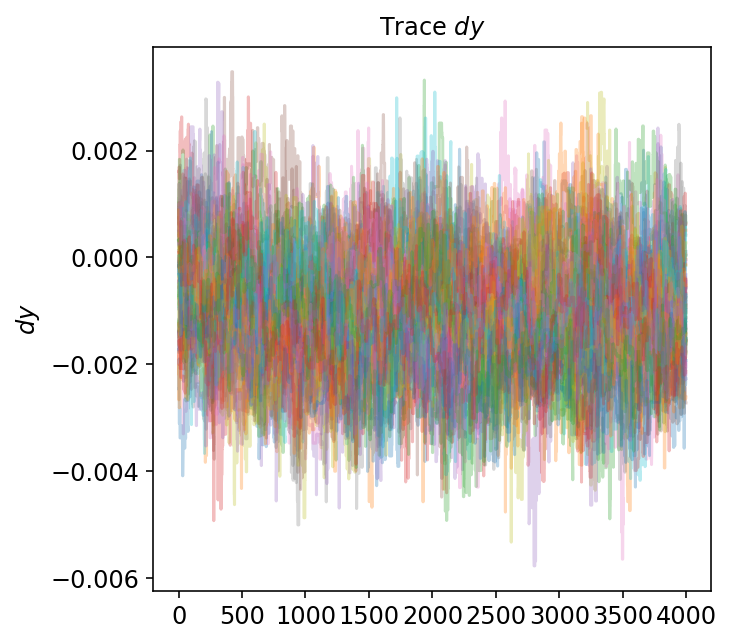

In [17]:
wdir = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/posteriors/'
noiseless_lowv = make_chain('simp5_std_medr_lowv_noiseless.h5', 1000, stray=False, trace=True)
noisy_lowv = make_chain('simp5_std_medr_lowv_noisy.h5', 1000, stray=False, trace=True)

In [15]:
from post_summary import post_summary

simp5_lowv = [noiseless_lowv, noisy_lowv]
simp5_lbl = ['noiseless', 'noisy']
names = ['i', 'PA', 'M', 'r_l', 'z0', 'zpsi', 'Tb0', 'Tbq', 'Tback', 'dV0', 'vsys', 'dx', 'dy']

for i in range(len(simp5_lowv)):
    print('simp5 lowv %s best-fit parameters' % (simp5_lbl[i]))
    for j in range(len(names)-3):
        post_param = post_summary(simp5_lowv[i][:,j], prec=0.001, mu='peak')
        print('%s = %.2f +%.3f / -%.3f' % (names[j], post_param[0], post_param[1], post_param[2]))
    print()

simp5 lowv noiseless best-fit parameters
i = 39.91 +0.101 / -0.077
PA = 129.99 +0.039 / -0.033
M = 2.00 +0.007 / -0.007
r_l = 539.33 +0.690 / -0.651
z0 = 1.51 +0.090 / -0.084
zpsi = 0.99 +0.017 / -0.014
Tb0 = 284.08 +2.336 / -1.952
Tbq = 0.50 +0.001 / -0.001
Tback = 16.24 +0.665 / -0.737
dV0 = 521.86 +4.200 / -3.440

simp5 lowv noisy best-fit parameters
i = 39.77 +0.080 / -0.067
PA = 130.08 +0.028 / -0.038
M = 2.01 +0.005 / -0.006
r_l = 536.93 +0.479 / -0.441
z0 = 1.61 +0.075 / -0.087
zpsi = 0.97 +0.015 / -0.012
Tb0 = 283.88 +2.206 / -2.243
Tbq = 0.50 +0.001 / -0.001
Tback = 17.38 +0.593 / -0.660
dV0 = 519.39 +3.857 / -3.888



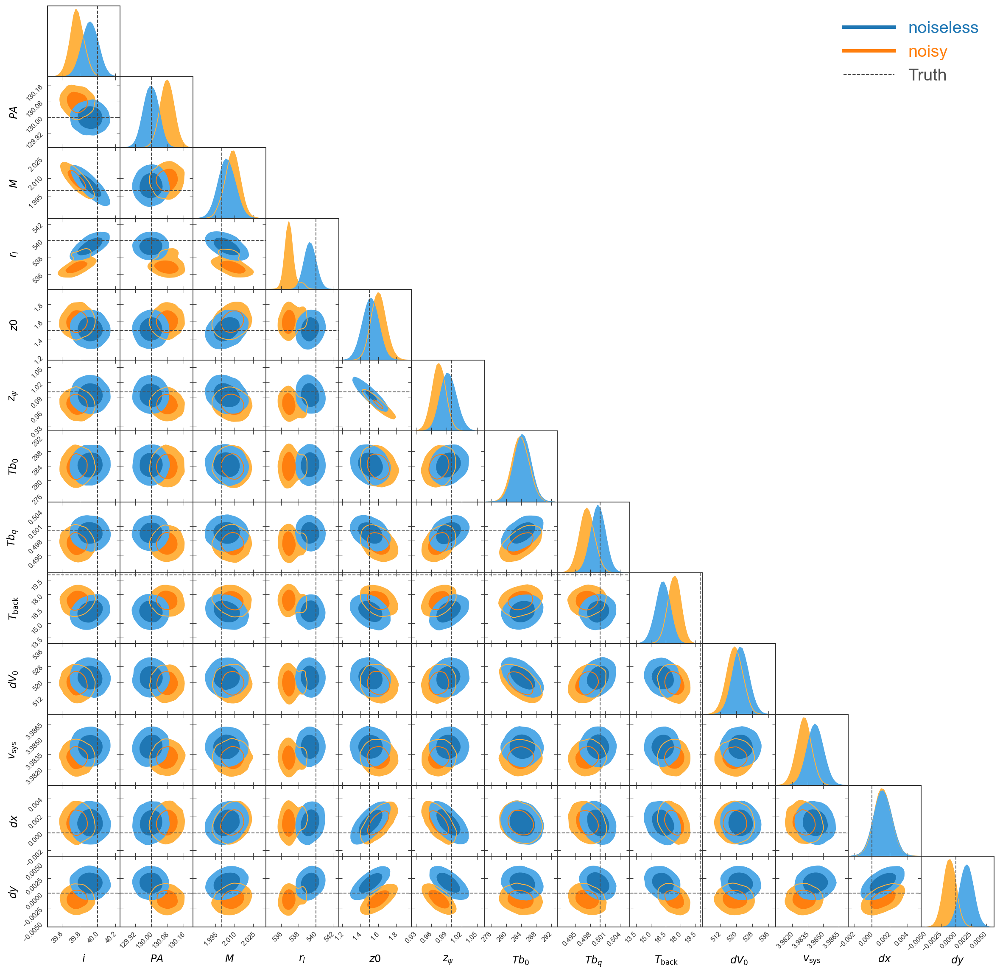

In [16]:
import pygtc

simp5_lowv = [noiseless_lowv, noisy_lowv]
simp5_lbl = ['noiseless', 'noisy']

# making corner plots
theta = [40, 130, 2.0, 540, 1.5, 1, 330, 0.5, 20, 441.4, 4.0, 0, 0]
lbls = [r'$i$', r'$PA$', r'$M$', r'$r_l$', r'$z0$', r'$z_{\psi}$', r'$Tb_{0}$', r'$Tb_q$', r'$T_{\rm{back}}$', r'$dV_{0}$', r'$v_{\rm{sys}}$', r'$dx$', r'$dy$']

# full corner plot
GTC = pygtc.plotGTC(chains=simp5_lowv, truths=theta, paramNames=lbls, chainLabels=simp5_lbl,
                    truthLabels='Truth', legendMarker = 'All', customTickFont= {'family':'Arial', 'size':8},
                    customLabelFont = {'family':'Arial', 'size':12}, customLegendFont = {'family':'Arial', 'size':20},
                    figureSize=20)
# GTC.savefig(wdir + 'posterior_plots/cornerplot_no_rms0.png', dpi=300)

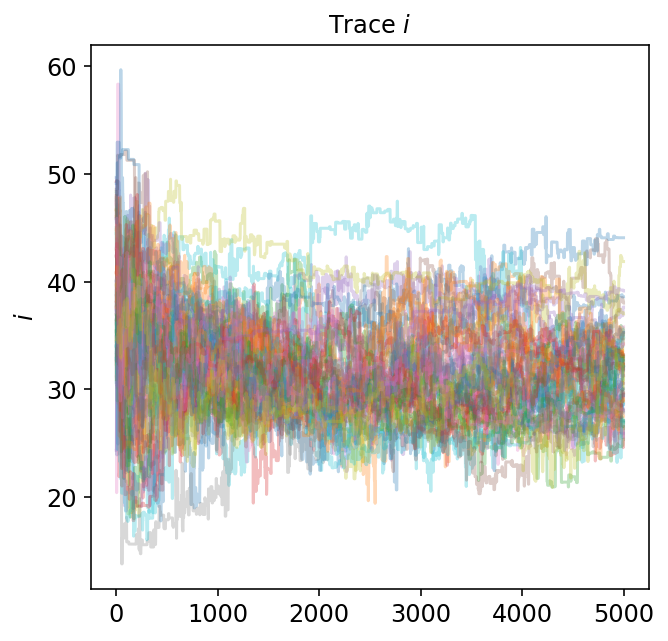

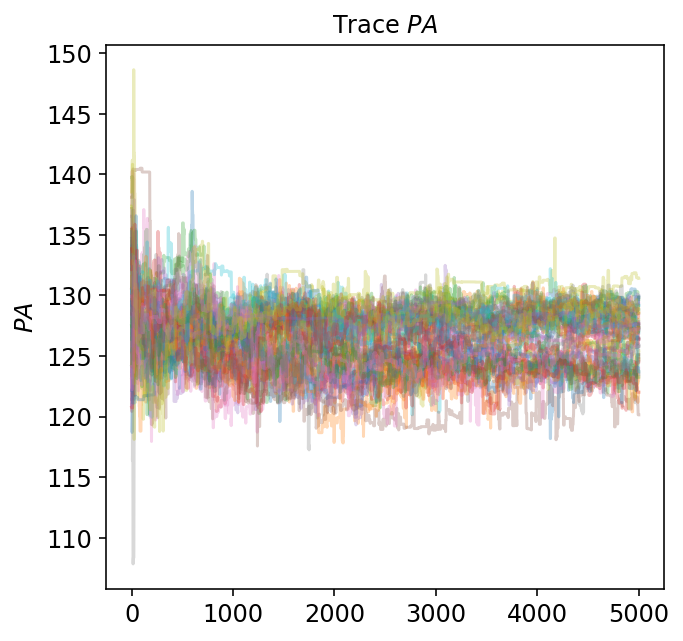

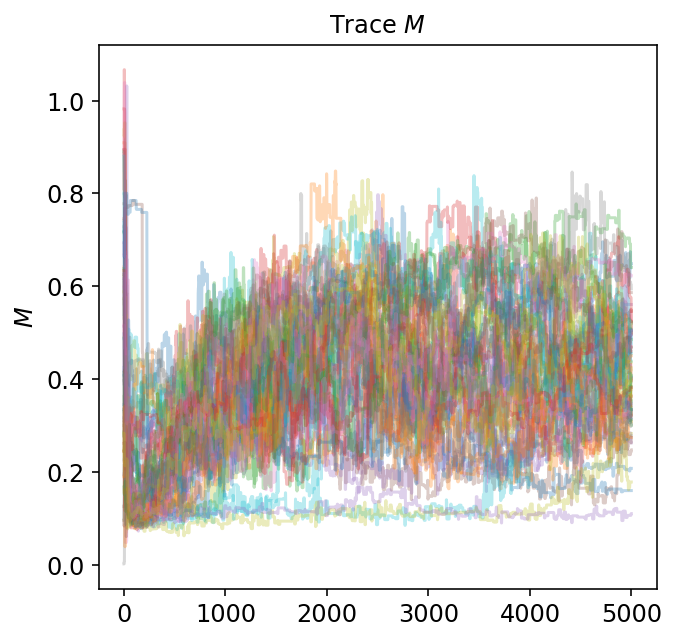

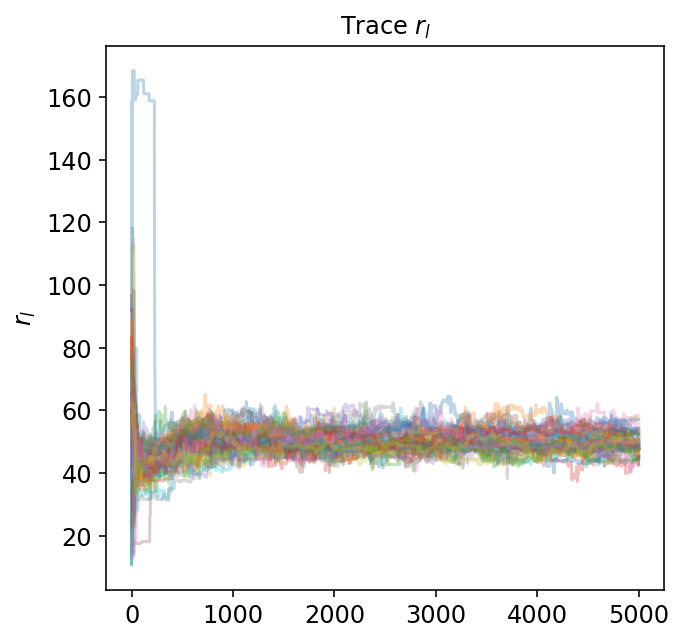

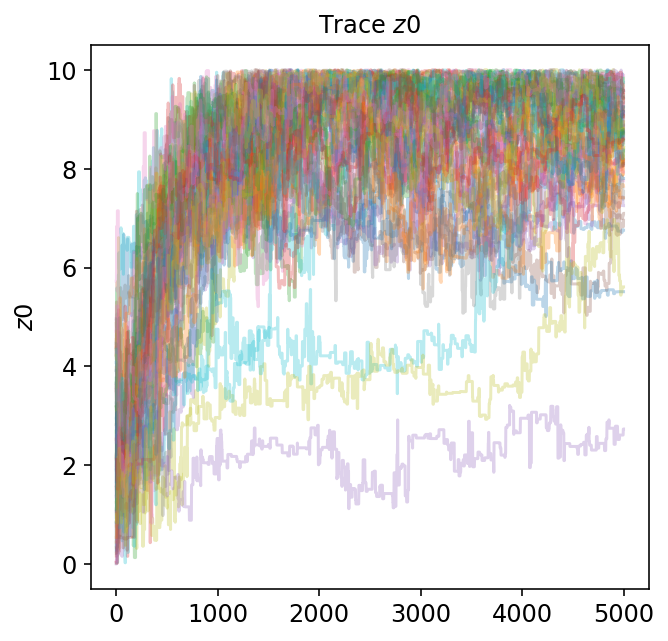

...

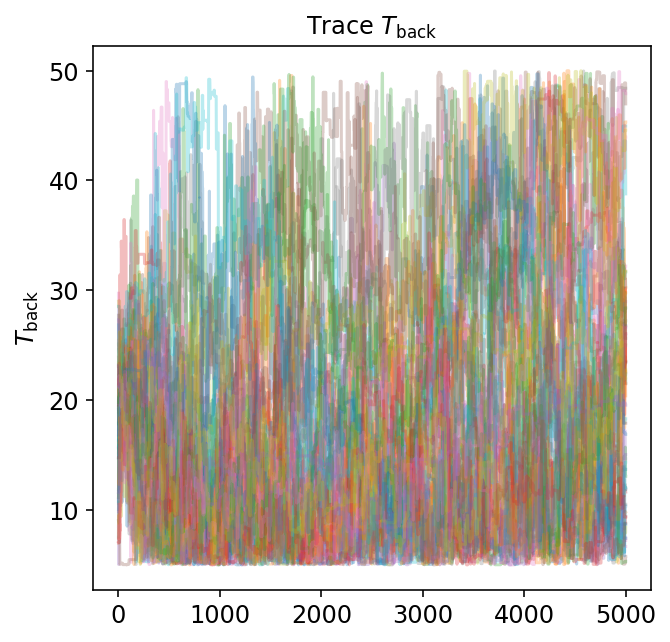

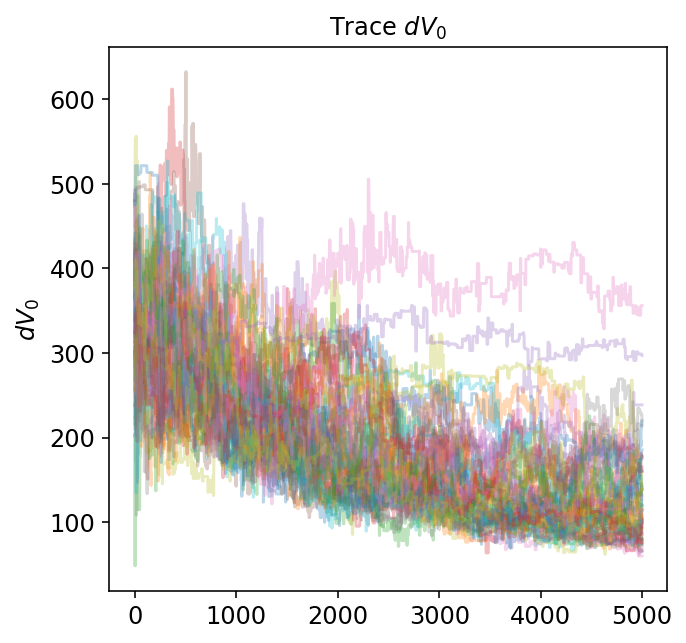

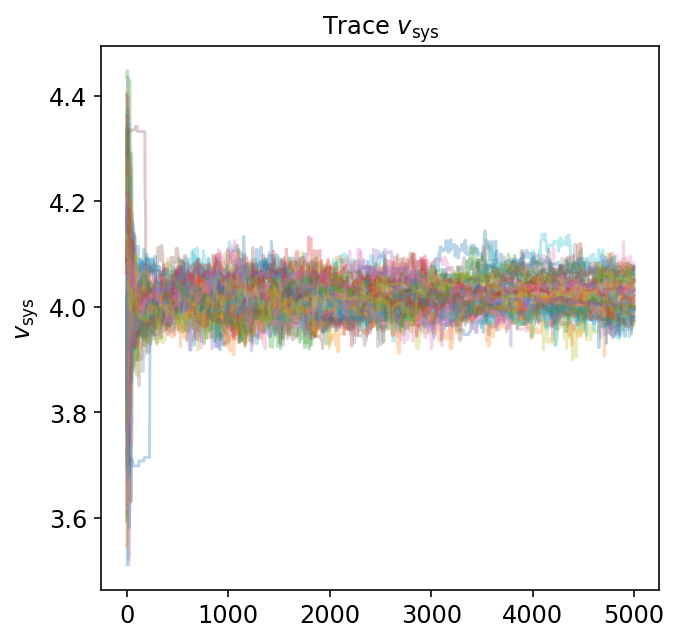

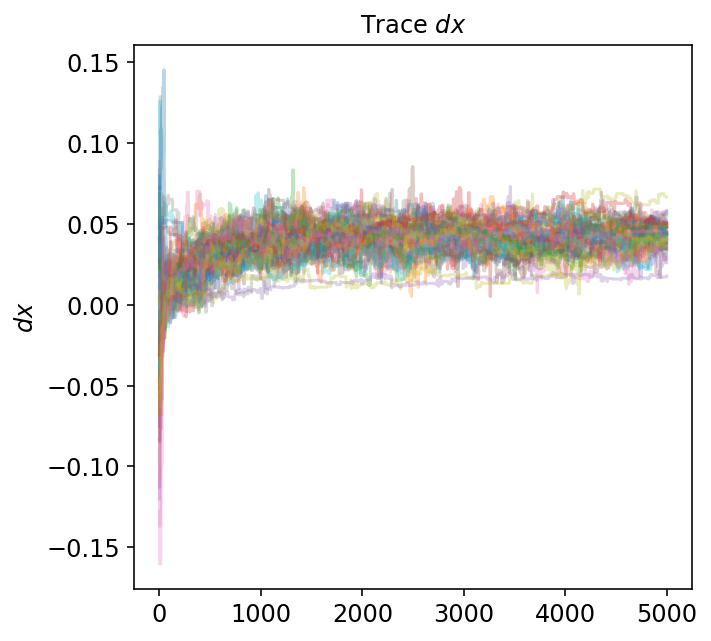

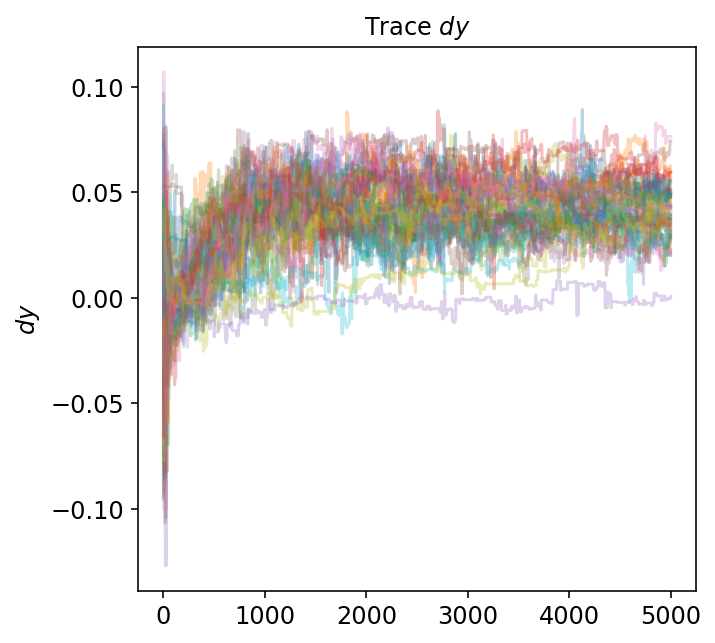

In [27]:
wdir = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/posteriors/'
noisy_simp1 = make_chain('simp1_std_medr_medv_noisy.h5', 0, stray=True, trace=True)
#noisy_lowv = make_chain('simp5_std_medr_lowv_noisy.h5', 1000, stray=False, trace=True)

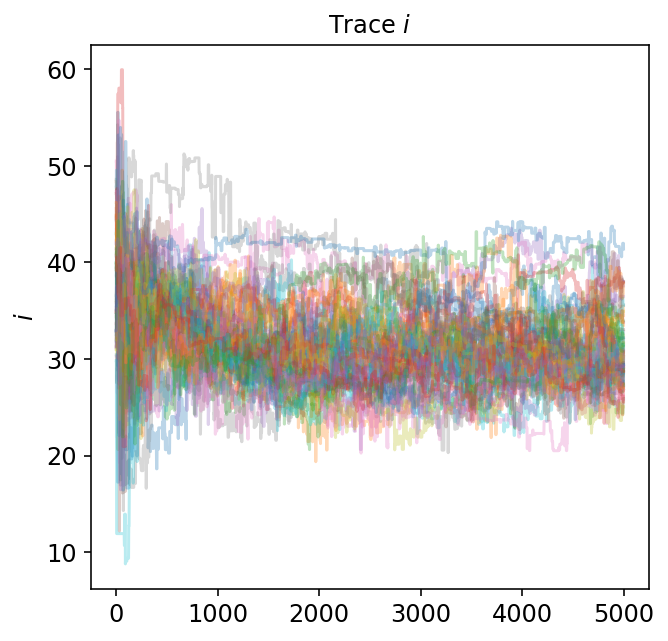

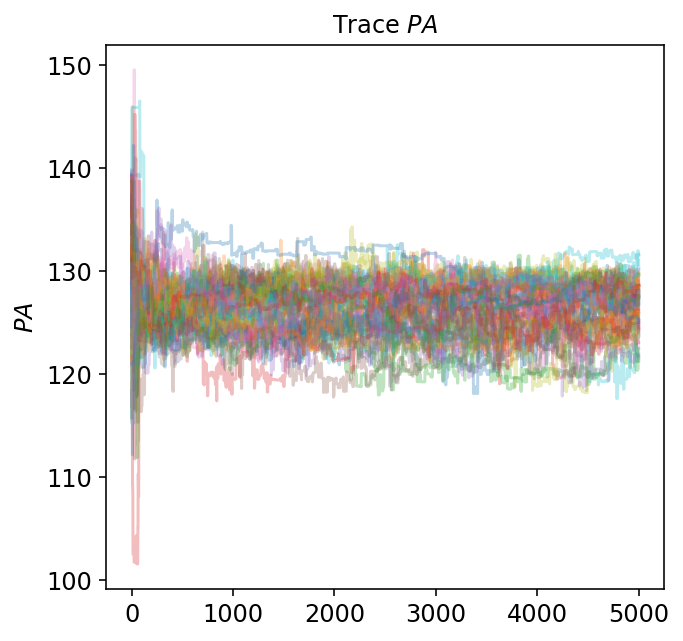

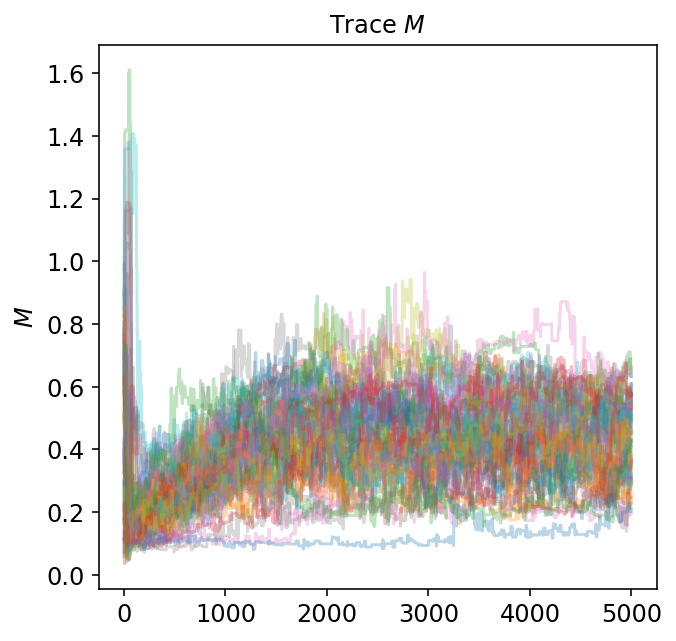

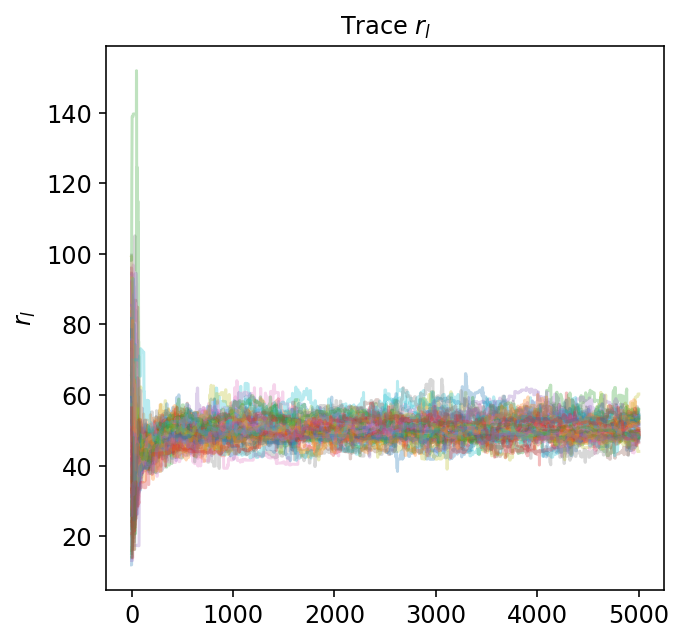

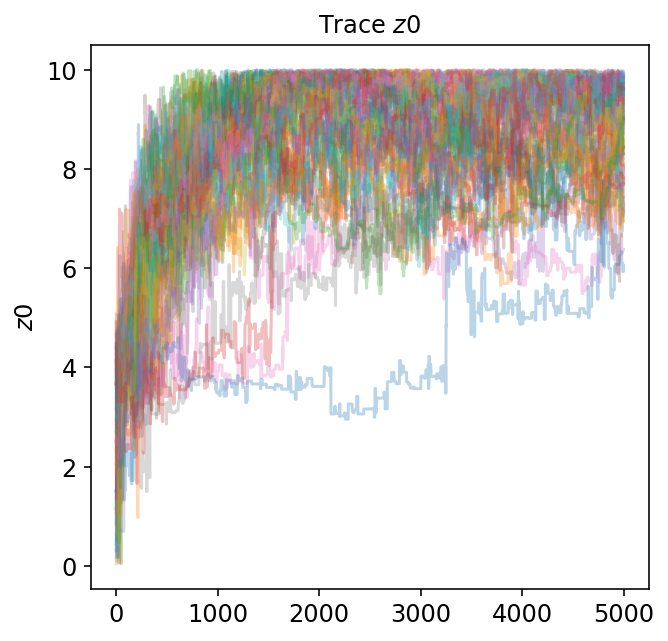

...

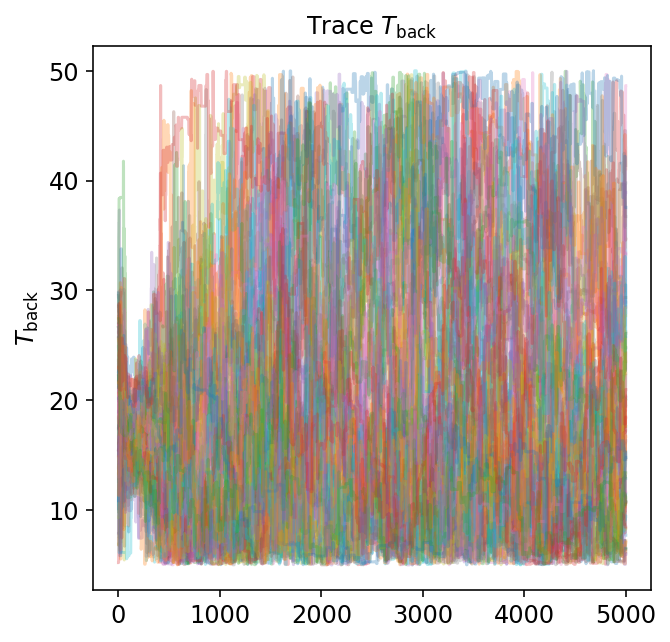

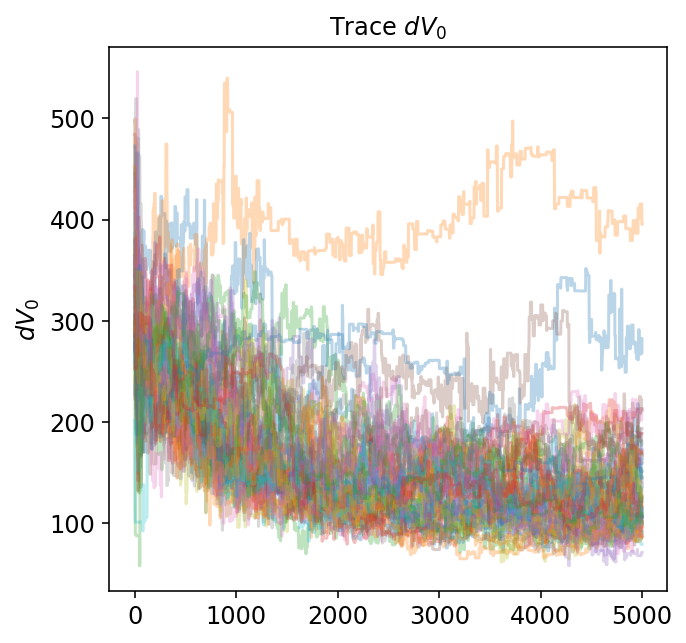

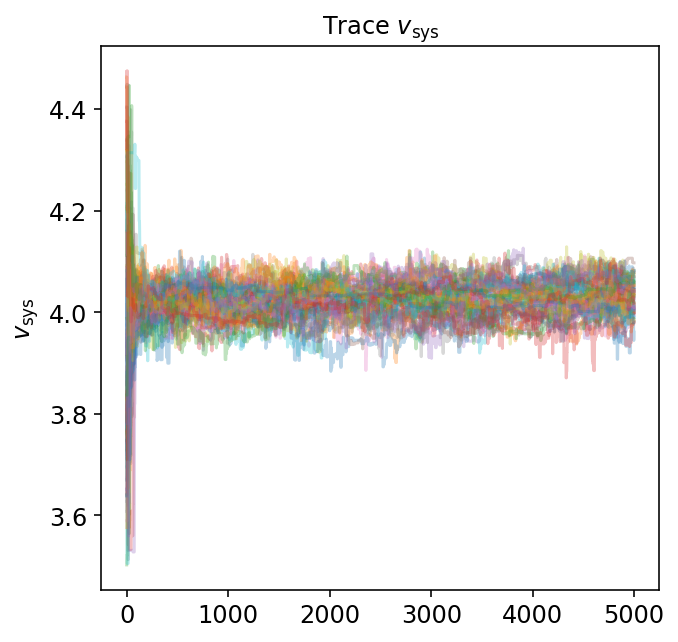

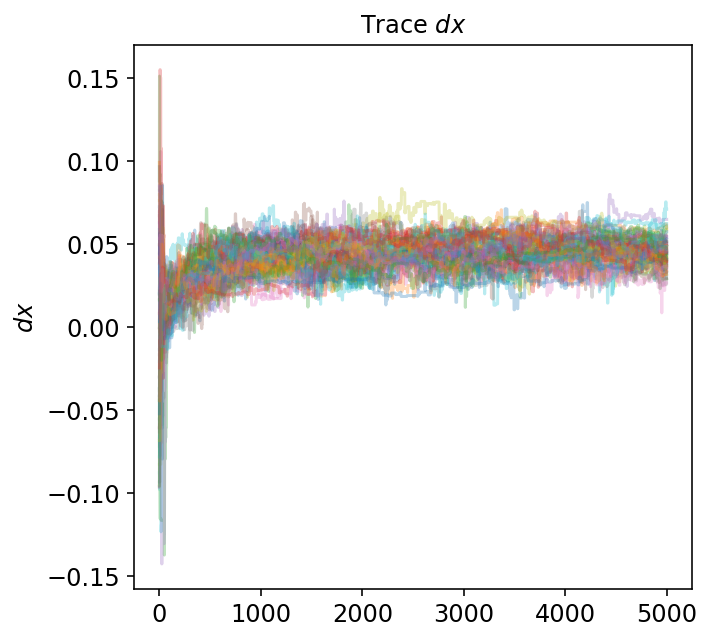

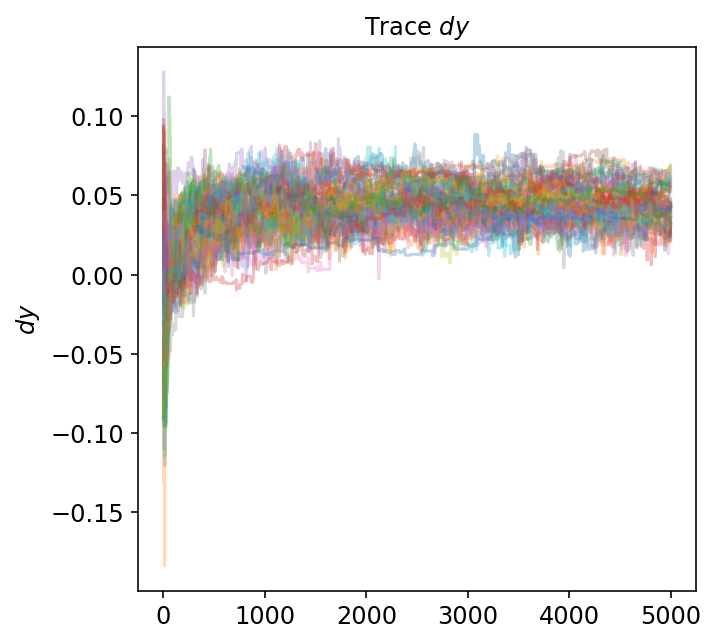

In [36]:
noisynew_simp1 = make_chain('simp1_std_medr_medv_noisynew.h5', 0, stray=False, trace=True)

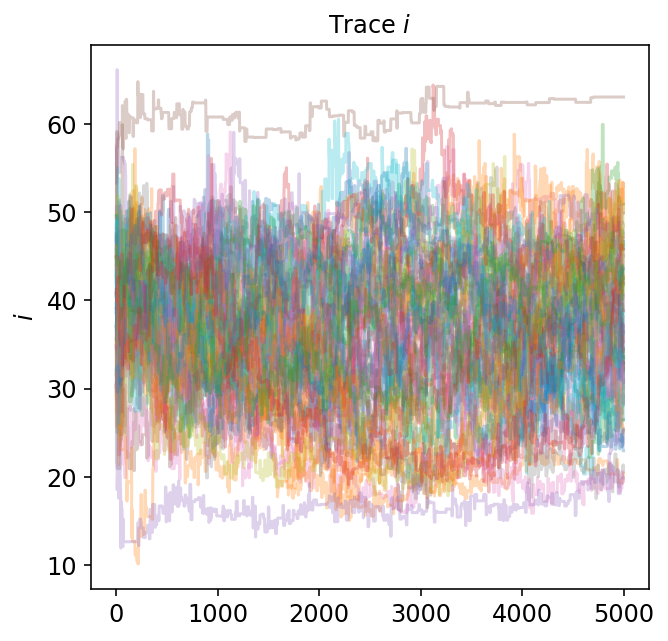

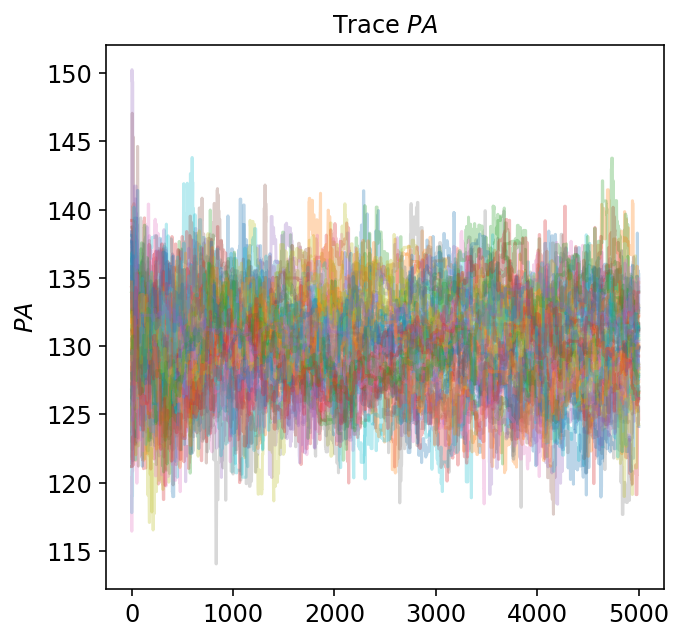

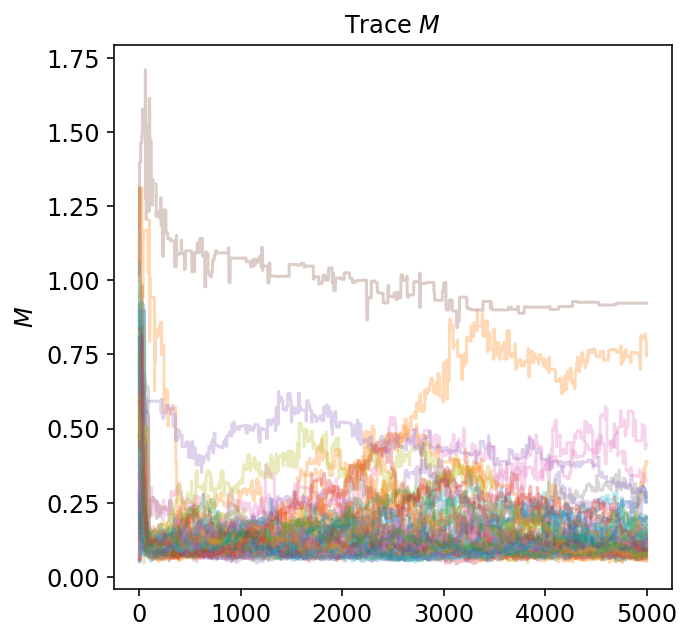

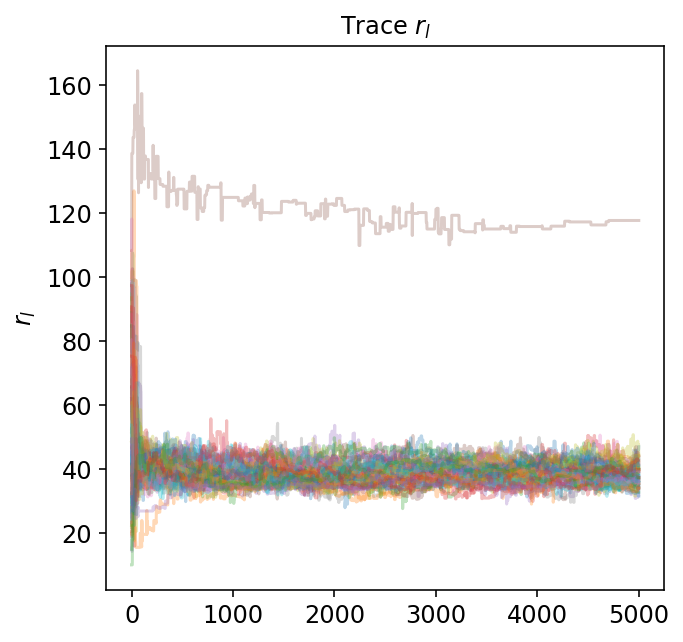

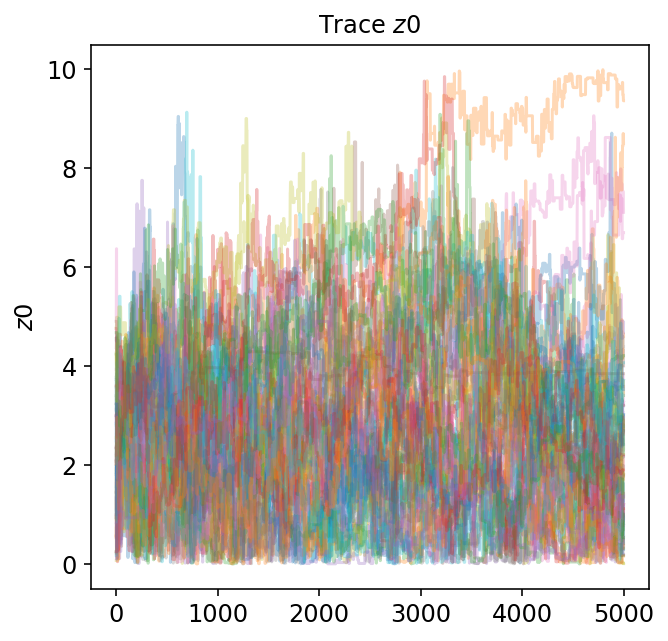

...

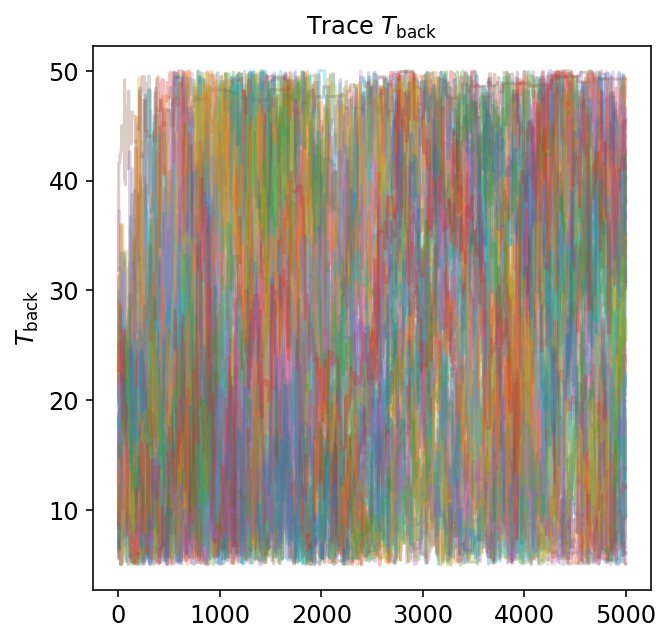

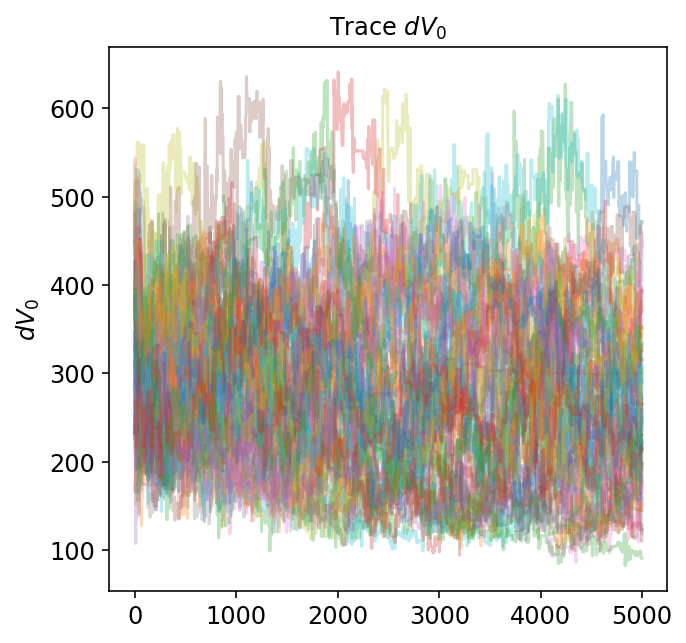

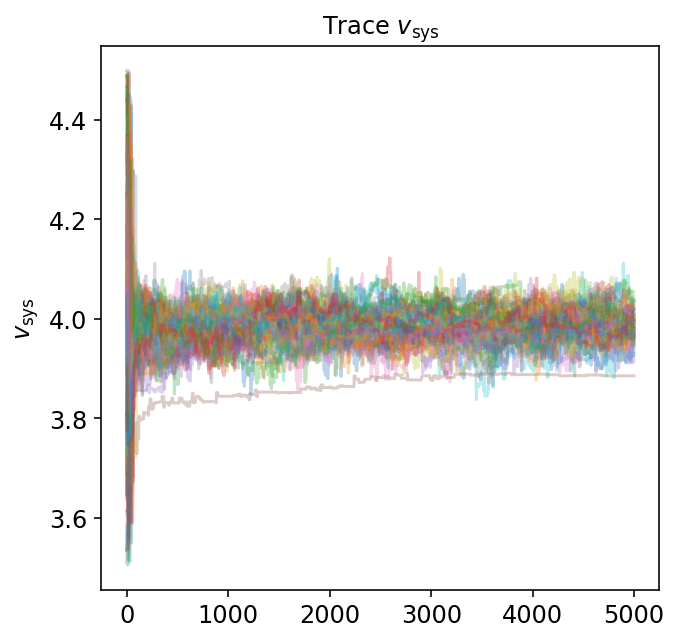

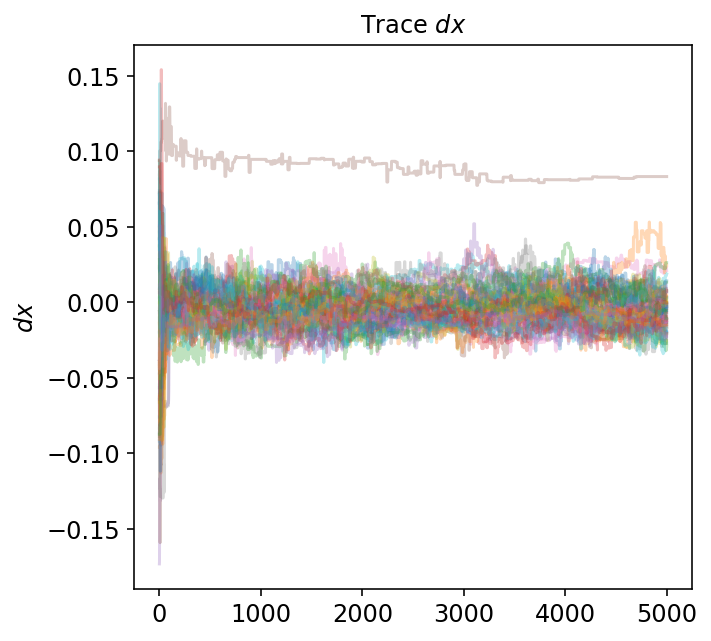

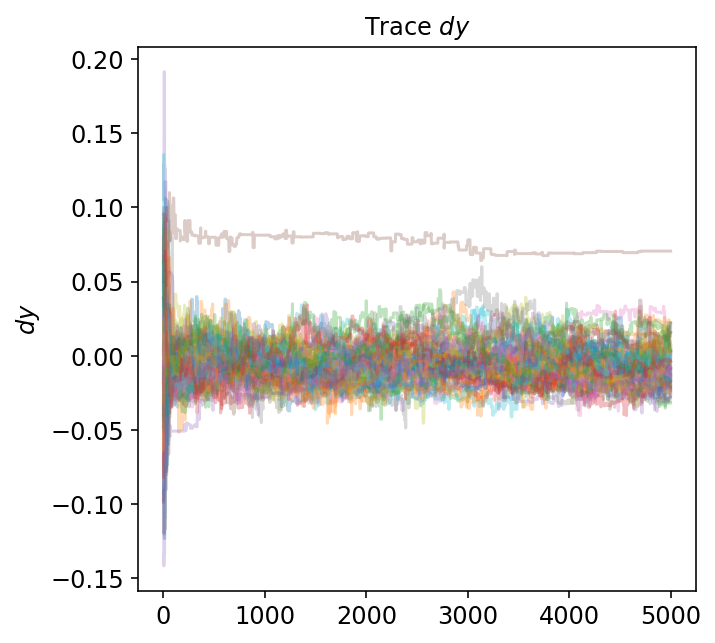

In [34]:
noiselessnew_simp1 = make_chain('simp1_std_medr_medv_noiselessnew.h5', 0, stray=False, trace=True)

# Censoring tests

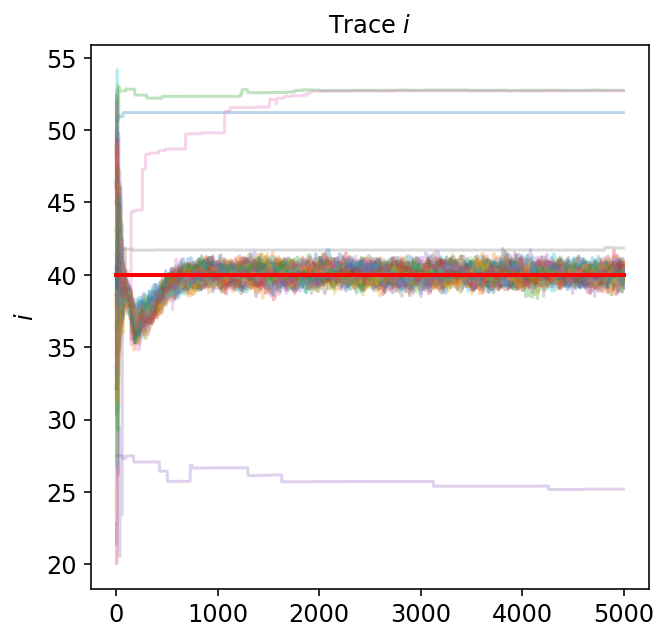

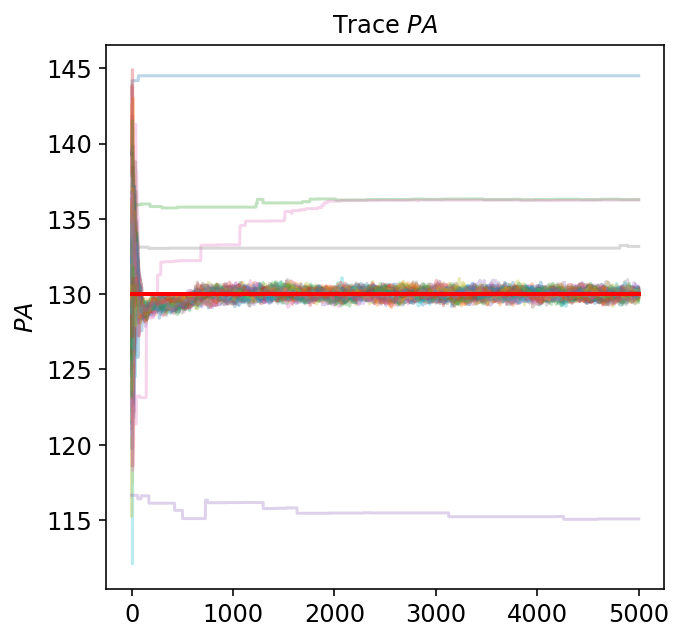

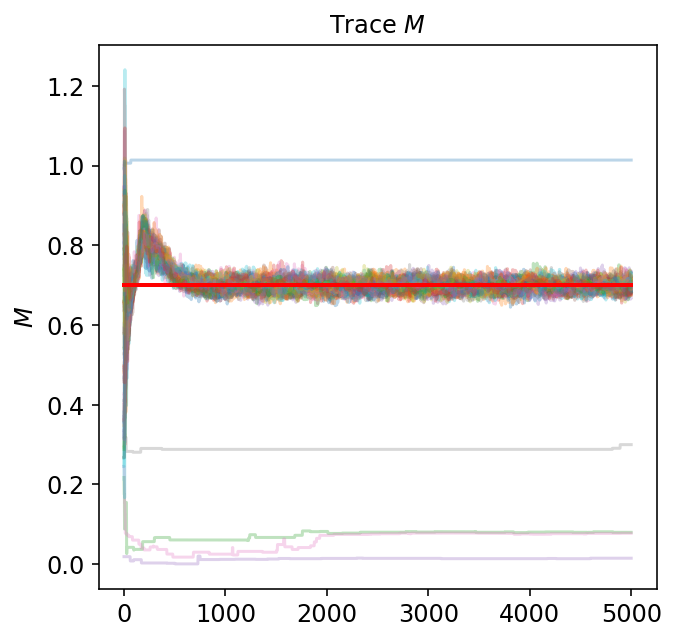

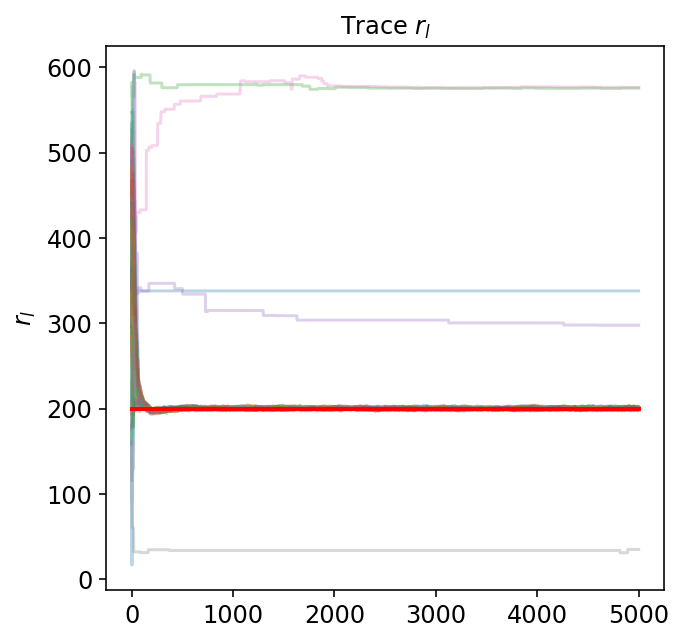

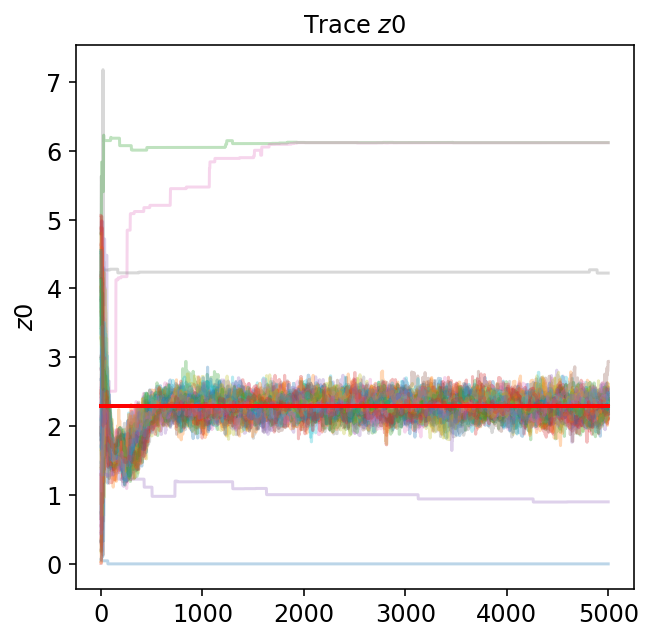

...

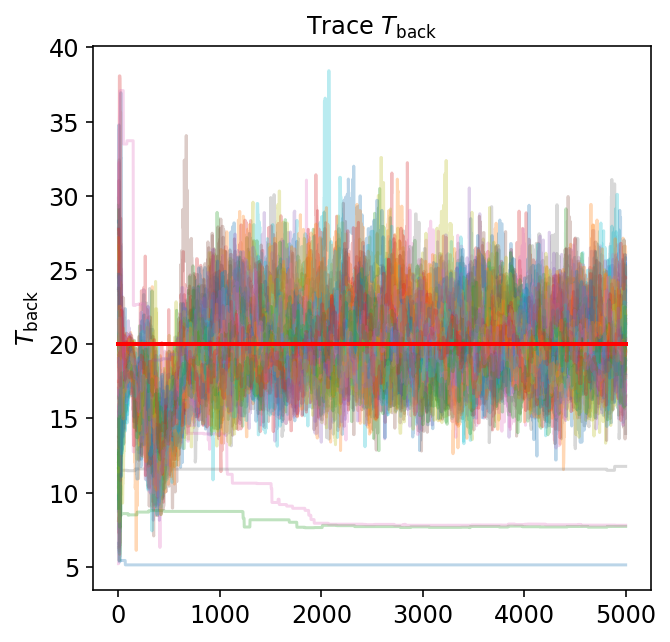

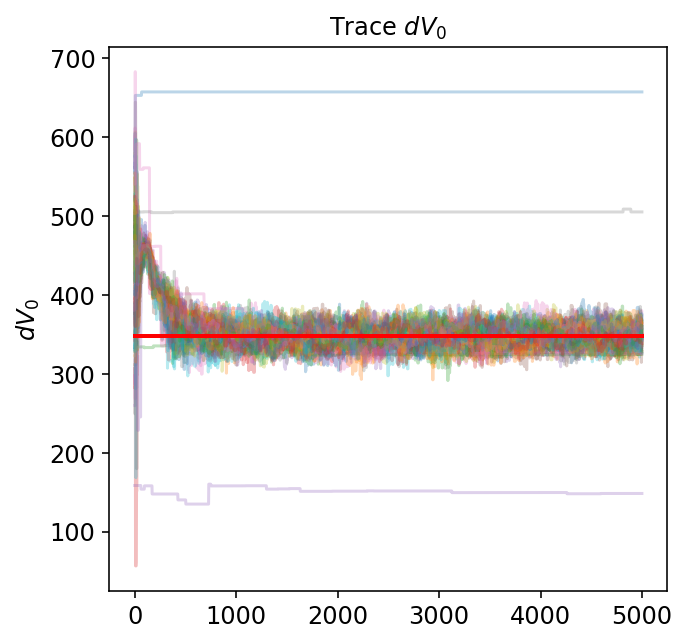

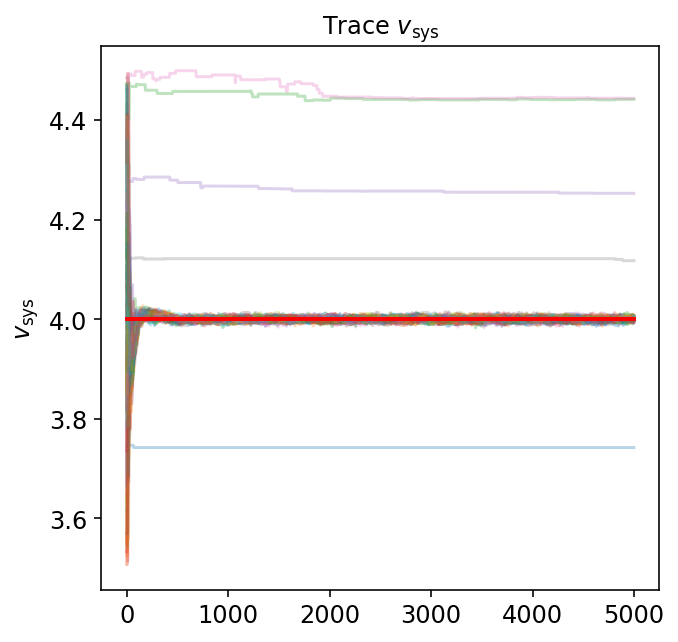

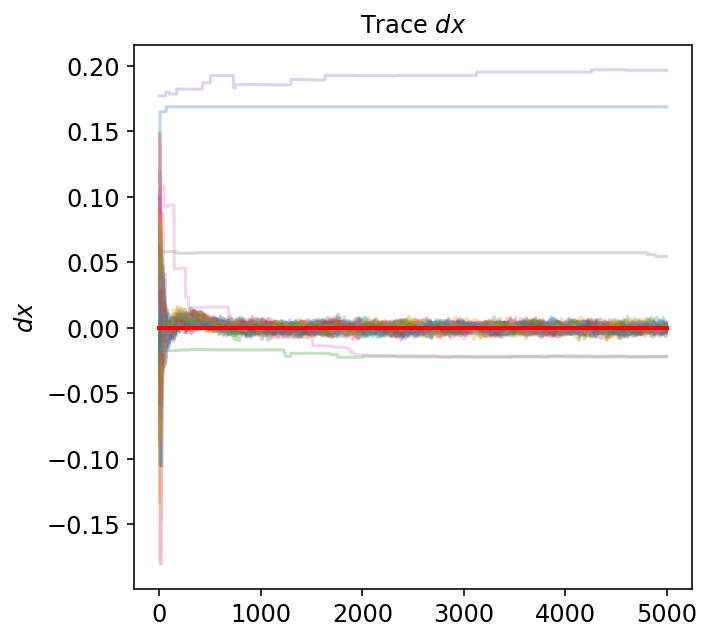

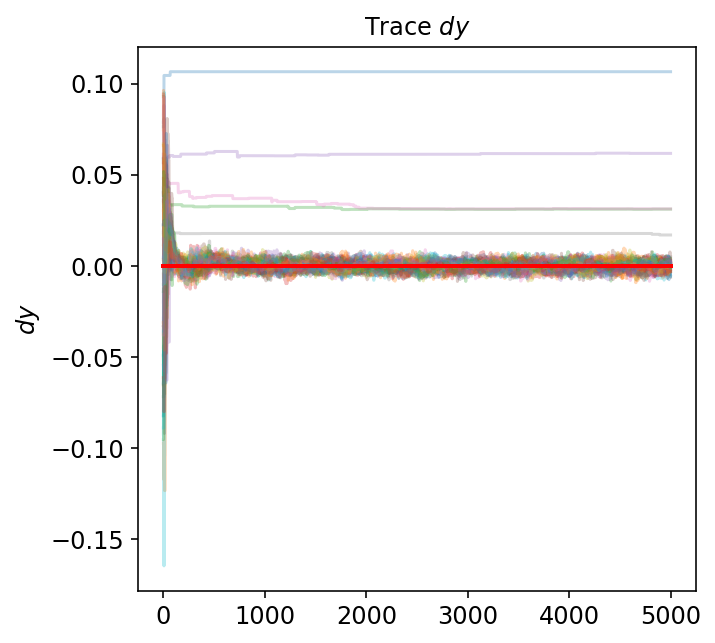

In [274]:
wdir = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/posteriors/'
theta = [40, 130, 0.7, 200, 2.3, 1, 205, 0.5, 20, 347.6, 4.0, 0, 0]
asym = make_chain('simp3_std_medr_medv_noiseless_asym1.h5', 0, stray=False, trace=True, theta=theta)

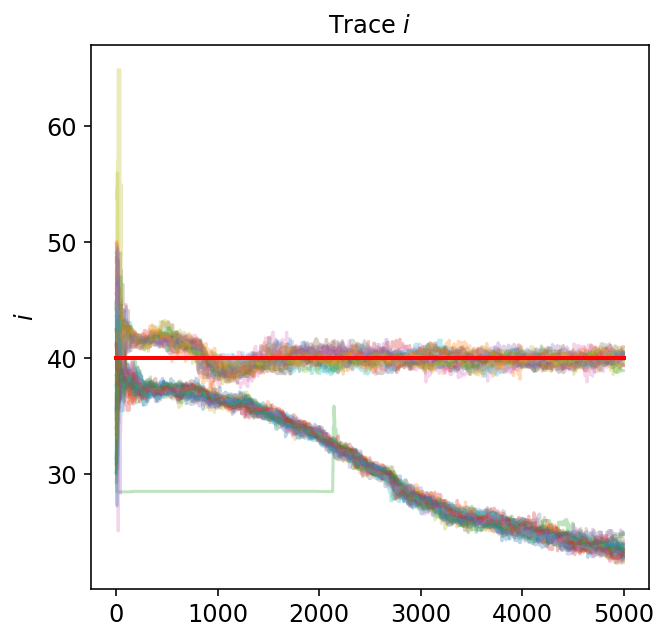

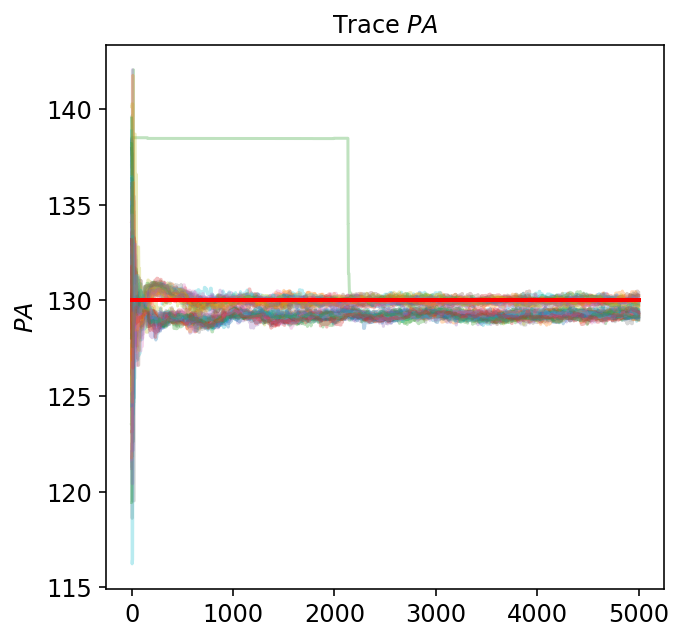

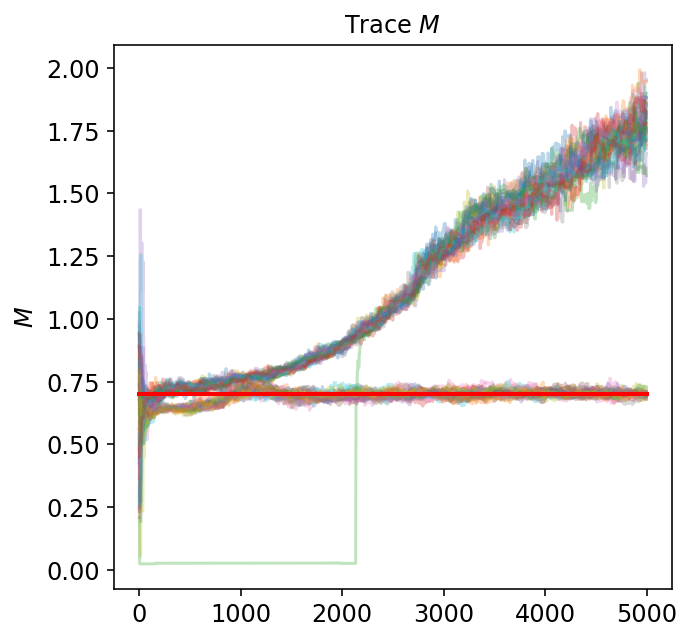

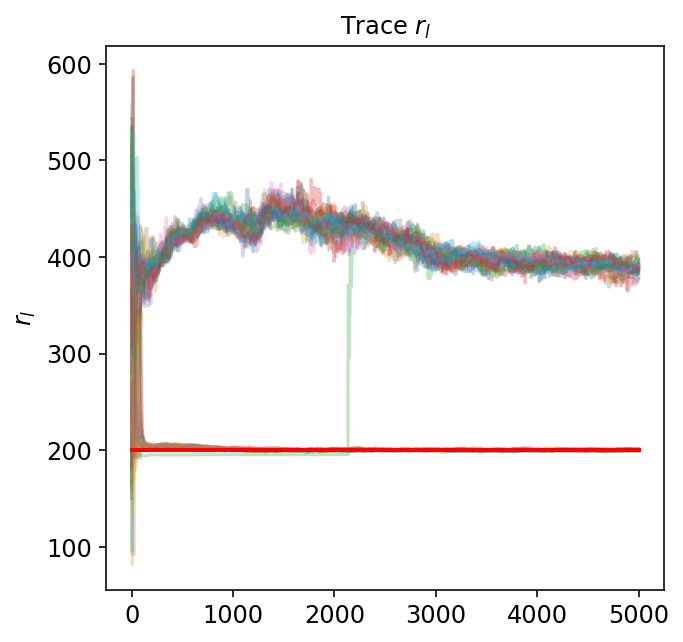

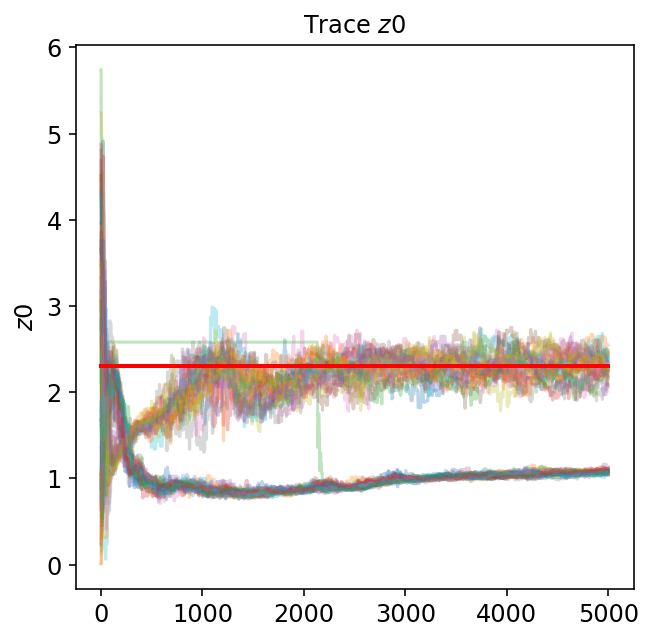

...

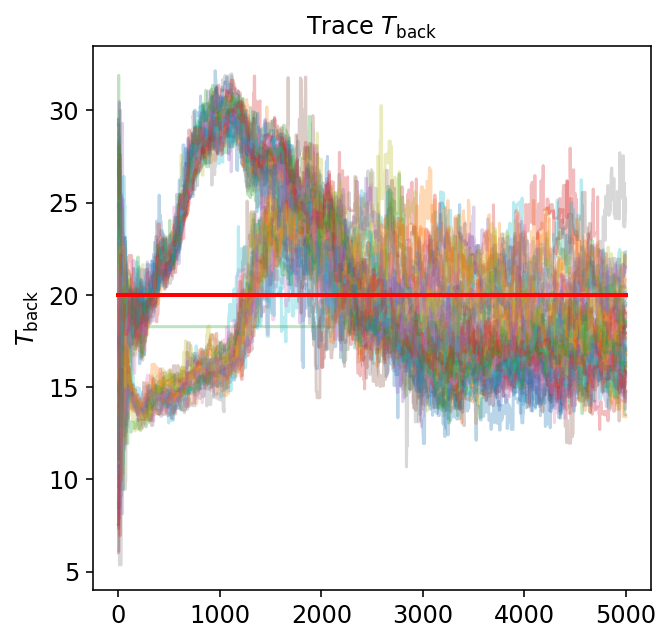

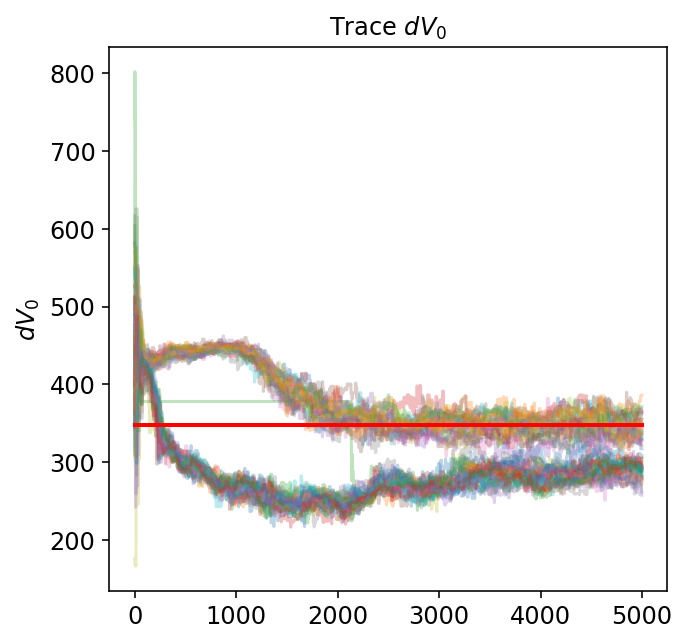

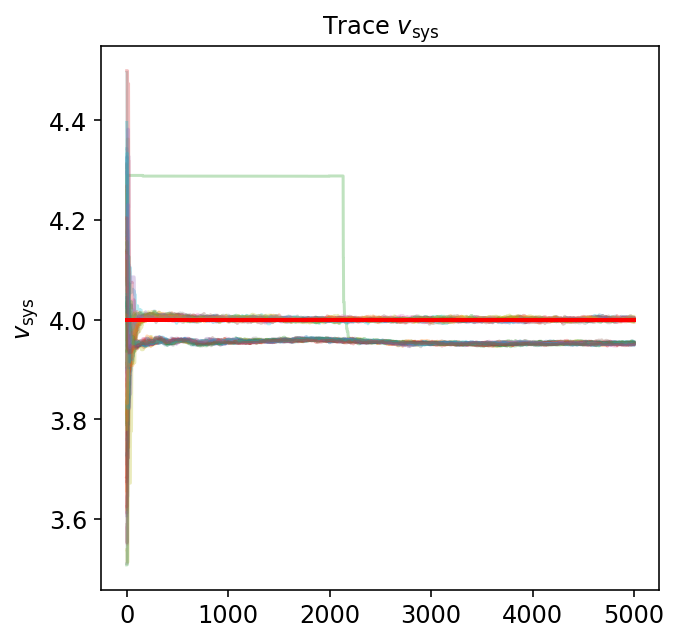

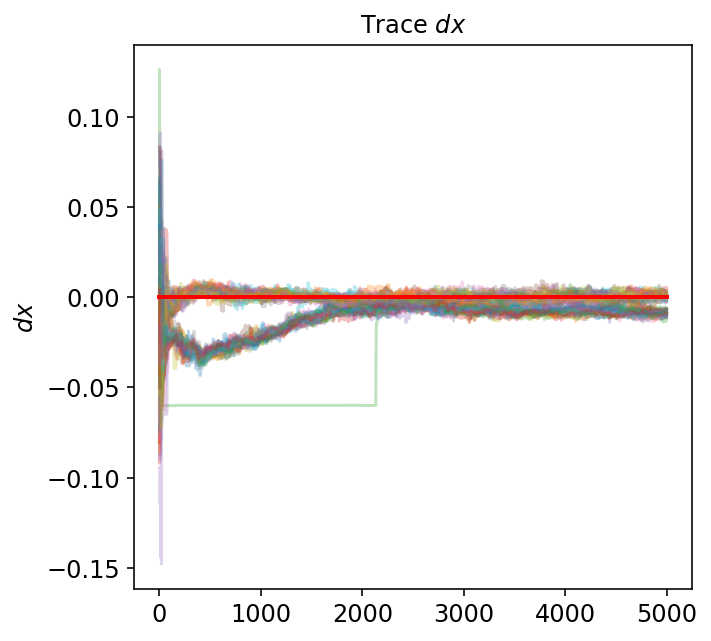

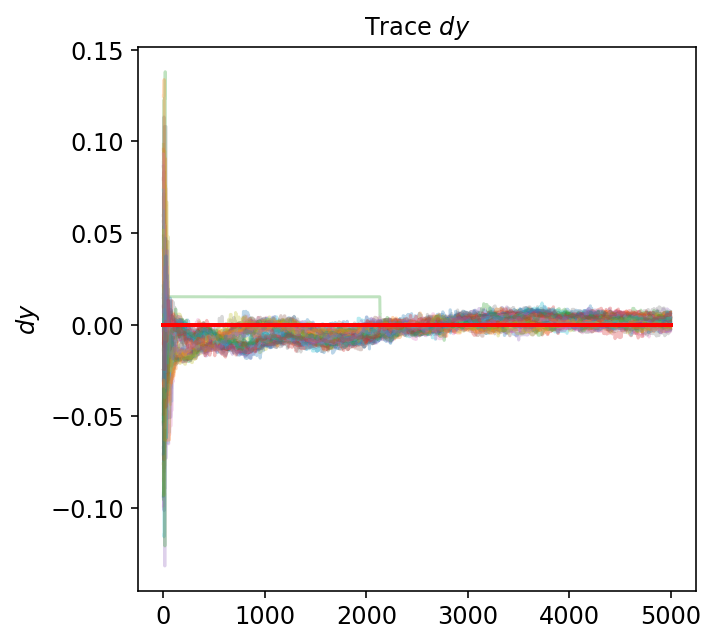

In [275]:
theta = [40, 130, 0.7, 200, 2.3, 1, 205, 0.5, 20, 347.6, 4.0, 0, 0]
sym = make_chain('simp3_std_medr_medv_noiseless_sym1.h5', 0, stray=False, trace=True, theta=theta)

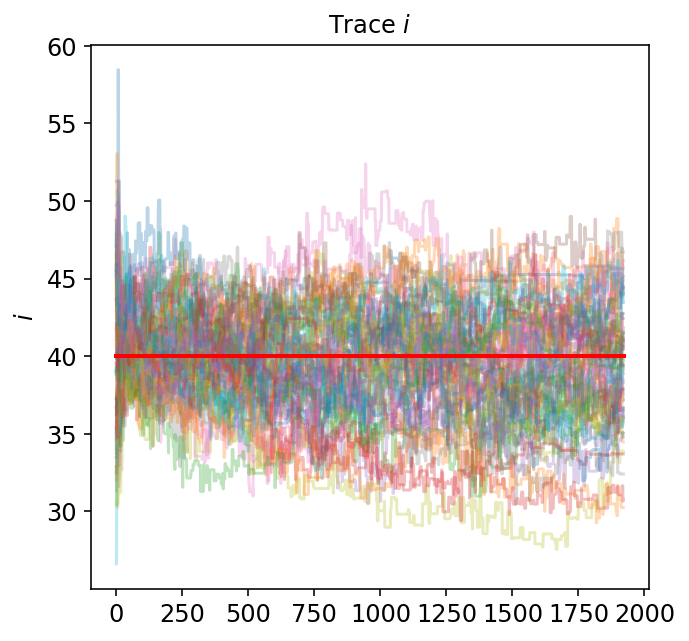

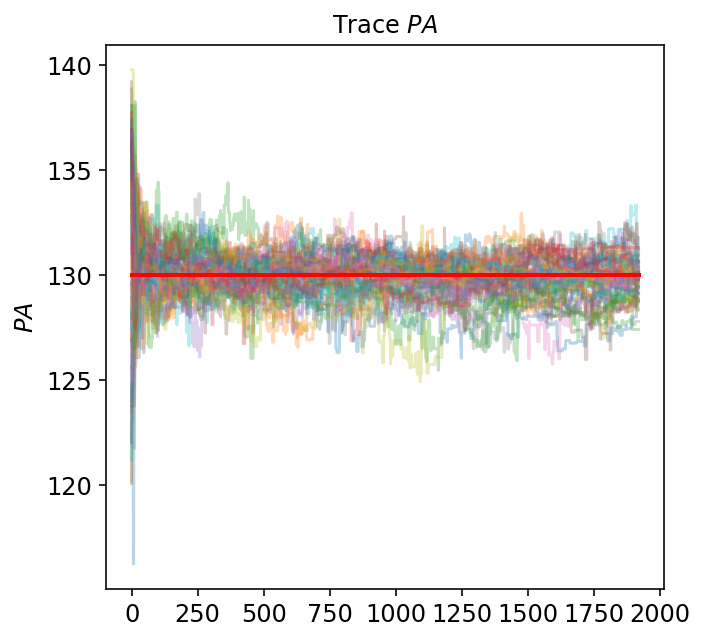

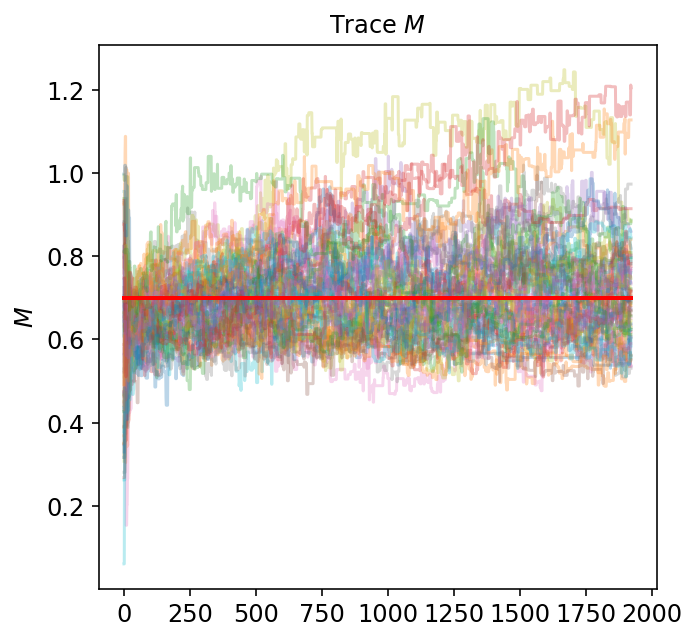

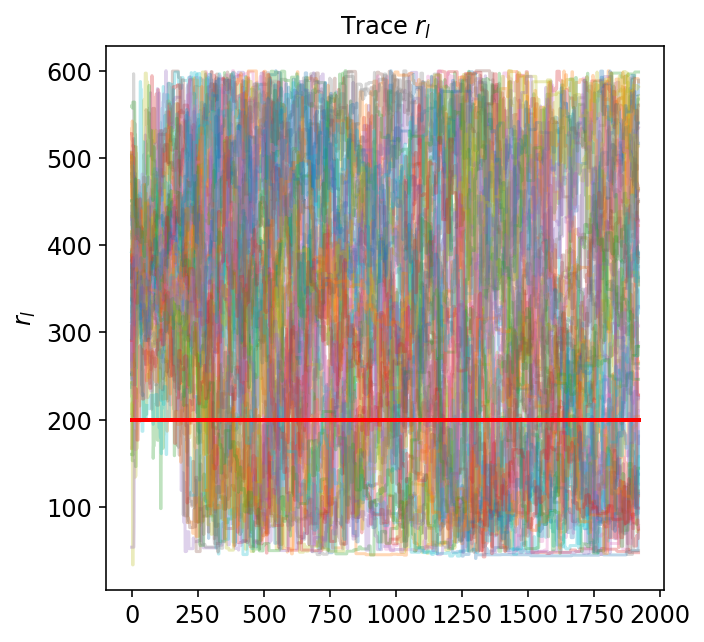

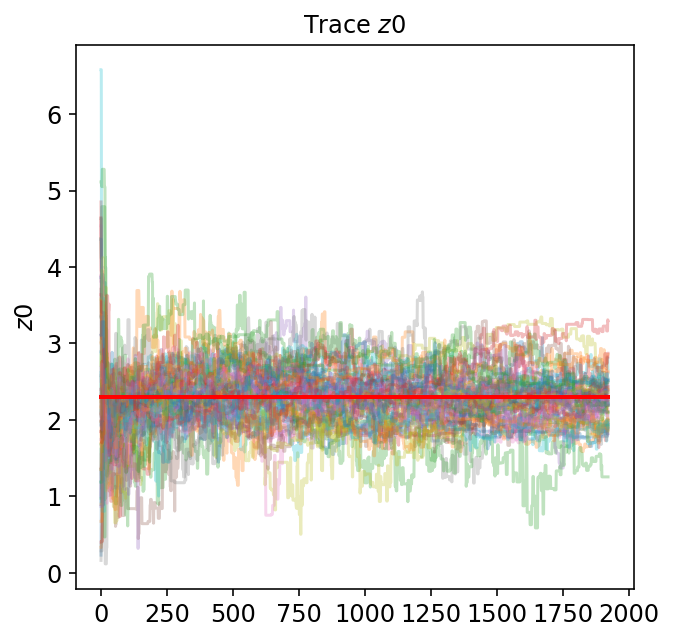

...

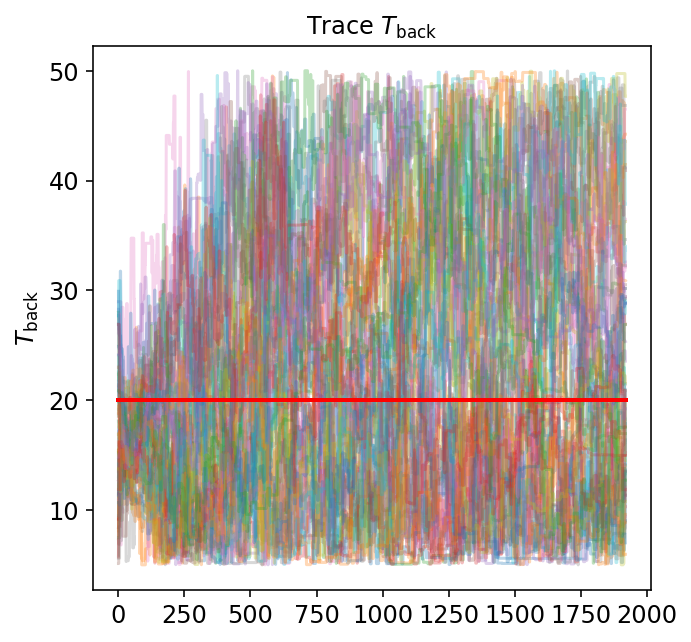

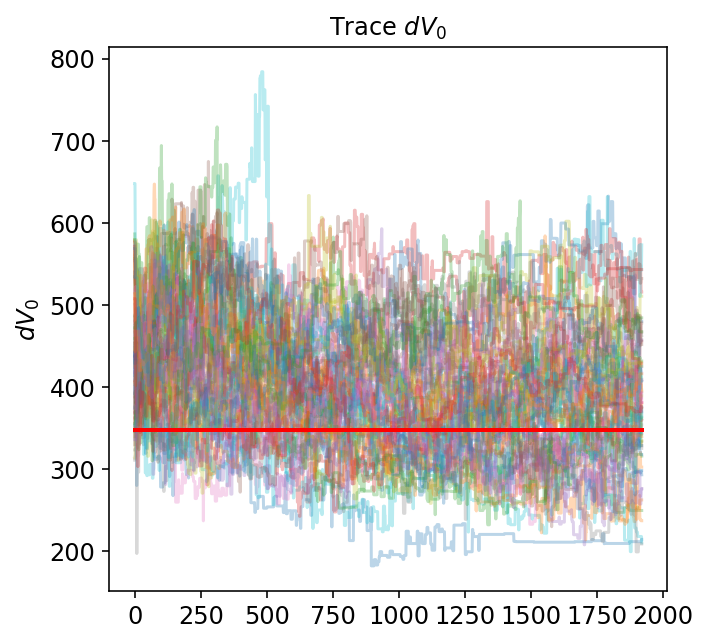

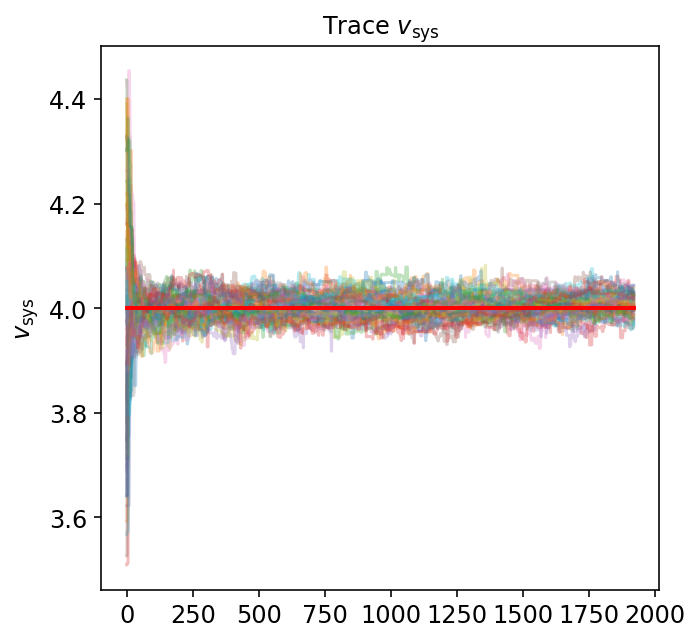

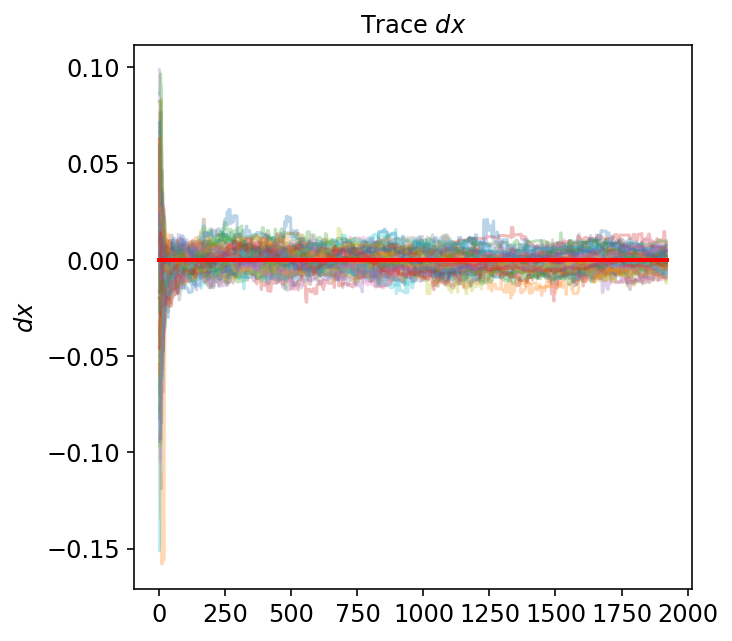

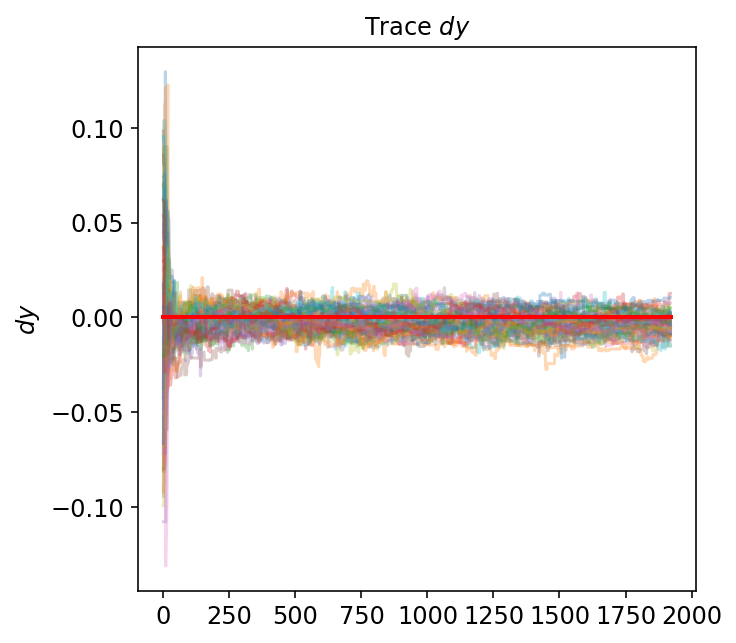

In [6]:
wdir = '/Users/justinvega/Documents/GitHub/dyn-masses/fit_Mdyn/posteriors/'
theta = [40, 130, 0.7, 200, 2.3, 1, 205, 0.5, 20, 347.6, 4.0, 0, 0]
wide = make_chain('simp3_std_medr_medv_noiseless_wide1.h5', 0, stray=False, trace=True, theta=theta)